## LIBRARIES

In [5]:
#imports
import spacy
from spacy.tokens import Doc, Token
from spacy.matcher import Matcher
from typing import List, Tuple, Dict
import re
import os
import pandas as pd
import xml.dom.pulldom as pulldom
from Classes import TableCreator, TextProcess #PatentExtract
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn import tree
from sklearn.pipeline import Pipeline
from sklearn.model_selection import GridSearchCV
from sklearn.svm import SVC
from sklearn.utils import shuffle
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.linear_model import SGDClassifier
from sklearn.svm import LinearSVC
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from statsmodels.stats.weightstats import DescrStatsW
import xgboost as xgb
from xgboost import plot_importance
from Classes import Experiments
import dill



## INITIAL PROCESSING FROM XML

In [12]:
class PatentExtract():

    def __init__(self, node):
        self.node = node

    def getAttribute(self,attr):
        attribute = []
        try:
            attribute.append(self.node.getAttribute(f"{attr}"))
        except:
            pass
        
        return attribute

    def singleTagTextExtract(self,tag):
        text_NODE = self.node.getElementsByTagName(f"{tag}")
        text = []

        for i in text_NODE:
            try:
                text.append(i.firstChild.data)
            except:
                pass
        
        return text
        
    def multiTagTextExtract(self,tag,inner_tag,attr=None):
        text_NODE = self.node.getElementsByTagName(f"{tag}")
        text = []
        attr_list = []

        if attr != None:
            attr_flag = True
        else:
            attr_flag = False

        for i in text_NODE:
            
            if attr_flag == True:

                try:
                    attr_list.append(i.getAttribute(f'{attr}'))
                except:
                    pass

            for j in i.getElementsByTagName(f'{inner_tag}'):
                try:
                    text.append(j.firstChild.data)         
                            
                except:
                    pass

        if attr_flag == True:
            return text, attr_list
        else:
            return text
        
    def classificationExtract(self):

        classification_list = []

        section = self.multiTagTextExtract(tag = 'classification-ipcr', inner_tag='section')
        class_ = self.multiTagTextExtract(tag = 'classification-ipcr', inner_tag='class')
        subclass = self.multiTagTextExtract(tag = 'classification-ipcr', inner_tag='subclass')
        main_group = self.multiTagTextExtract(tag = 'classification-ipcr', inner_tag='main-group')
        sub_group = self.multiTagTextExtract(tag = 'classification-ipcr', inner_tag='subgroup')

        for i,sec in enumerate(section):
            try:
                sec_class = ''.join([sec,class_[i],subclass[i]])
            except:
                break
            try:
                groups = '/'.join([main_group[i],sub_group[i]])
            except:
                groups = ''

            output = ' '.join([sec_class,groups])  
            
            classification_list.append(output)

        return classification_list


In [13]:
db = TableCreator()

doc = pulldom.parse(os.path.join('C:\EPO Project\EPO Patent Data','EPDecisions.xml'))

for event, node in doc:

    if event == pulldom.START_ELEMENT and node.tagName=='ep-appeal-decision':
        try:
            doc.expandNode(node)
        except:
            pass
        #print("XML: ",node.toxml())
        patent_extractor = PatentExtract(node)
        #procedure lang
        lang = patent_extractor.getAttribute(attr='lang')
        db.append(db.procedure_lang,lang)
        #print(lang)
        #get court type e.g. T and appeal number
        appeal_num, court_type = patent_extractor.multiTagTextExtract(tag='ep-case-num',attr='code',inner_tag='ep-appeal-num')
        db.append(db.appeal_num,appeal_num)
        db.append(db.court_type,court_type)
        #print(appeal_num, court_type)
        #ECLI
        ecli = patent_extractor.singleTagTextExtract(tag='ep-ecli')
        db.append(db.ecli,ecli)
        #print(ecli)
        #get summary of facts
        #print('facts')
        sum_facts, fact_lang = patent_extractor.multiTagTextExtract(tag='ep-summary-of-facts',attr='lang',inner_tag='p')
        #print('pacts')
        db.append(db.summary_facts,sum_facts)
        db.append(db.fact_lang,fact_lang)
        #print(sum_facts)
        #print(fact_lang)
        #get reason for decision
        reasons = patent_extractor.multiTagTextExtract(tag='ep-reasons-for-decision',inner_tag='p')
        db.append(db.decision_reason,reasons)
        #print(reasons)
        #get order
        order = patent_extractor.multiTagTextExtract(tag='ep-appeal-order',inner_tag='p')
        db.append(db.order,order)
        #print(order)
        #date
        date = patent_extractor.multiTagTextExtract(tag='ep-date-of-decision',inner_tag='date')
        db.append(db.date,date)
        #print(date)
        #invention title
        title = patent_extractor.singleTagTextExtract(tag='invention-title')
        db.append(db.title,title)
        #print(title)
        #board of appeal code i.e. 3.2.03
        code = patent_extractor.singleTagTextExtract(tag='ep-board-of-appeal-code')
        db.append(db.board_code,code)
        #print(code)
        #patent keywords
        keywords = patent_extractor.multiTagTextExtract(tag='ep-keywords',inner_tag='keyword')
        db.append(db.keywords,keywords)
        #print(keywords)
        _, reference = patent_extractor.multiTagTextExtract(tag='ep-appeal-bib-data',attr='reference',inner_tag=None)
        db.append(db.reference,reference)
        #classification 
        classification = patent_extractor.classificationExtract()
        db.append(db.classification, classification)       


SAXParseException: <unknown>:12025:9764: mismatched tag

In [ ]:
db.create_table()

df = db.df

In [ ]:
df = df.applymap(lambda x: ' '.join(x))

In [ ]:
#Process incorrect dates by taking them from the end of the ECLI number 
df['Date'] = df.apply(lambda row: row.ECLI.split('.')[1] if len(row.Date)<8 else row.Date,axis=1)

In [ ]:
#convert dates to datetime
df['Date'] = pd.to_datetime(df['Date'])

In [ ]:
#replace empty space with NaN
df = df.replace(r'^\s*$', np.nan, regex=True)


In [ ]:
df['Year'] = df['Date'].dt.year

## TRAINING DATA PROCESSING

In [5]:
#read in file created by previous section
df = pd.read_pickle("EPODecisionsProcessed")

In [6]:
t_dffff = df.loc[(df['Court Type']=='T') & (df['Procedure Language']=='en') & (df['Order'].notna())]

In [7]:
date_group = t_dffff.groupby(['Year'], as_index=False).count()

Text(0, 0.5, 'Number of Decisions')

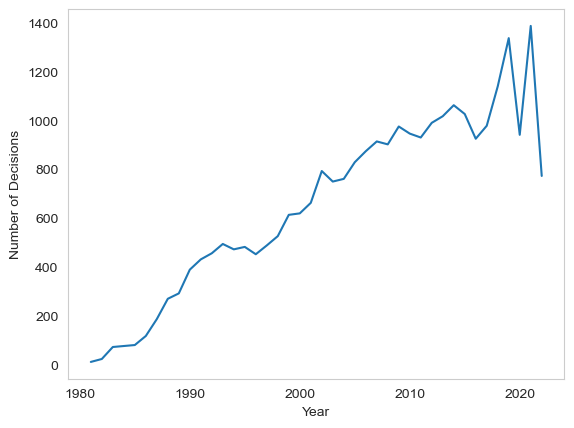

In [8]:
sns.set_style('whitegrid', {'axes.grid' : False})

sns.lineplot(data = date_group, x='Year',y='Reference')

#plt.xlabel('Type of Board')
plt.ylabel('Number of Decisions')

In [9]:
#Technical Court - Year >= 2000 and cases with an Outcome i.e. Order
t_df = df.loc[(df['Court Type']=='T') & (df['Procedure Language']=='en') & (df['Year']>=2000) & (df['Order'].notna())]

Text(0, 0.5, 'Number of Decisions')

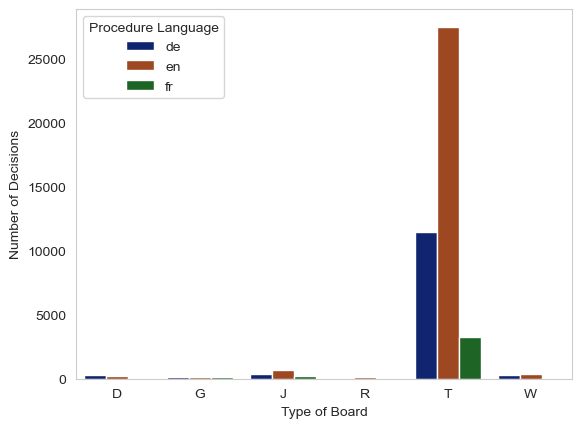

In [10]:
sns.set_style('whitegrid', {'axes.grid' : False})
sns.countplot(
    data=df,
    x="Court Type", hue="Procedure Language",
    palette="dark",)

plt.xlabel('Type of Board')
plt.ylabel('Number of Decisions')

<Axes: xlabel='count', ylabel='Board Code'>

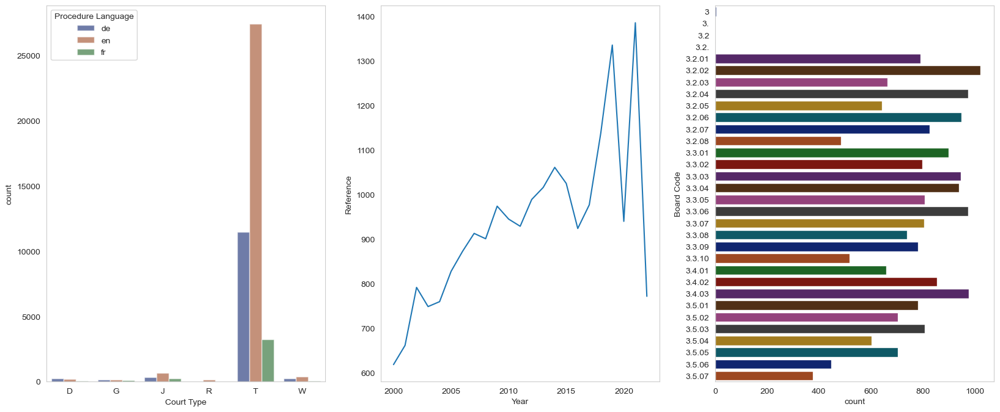

In [11]:
#PLOT DESCRIPTOVE STATS

#cases with outcome orders - 27444

fig, (ax1, ax2, ax3) = plt.subplots(1, 3,figsize = (20,8))

sns.countplot(
    data=df,
    x="Court Type", hue="Procedure Language",
    palette="dark", alpha=.6, ax=ax1
)

date_group = t_df.groupby(['Year'], as_index=False).count()

sns.lineplot(data = date_group, x='Year',y='Reference',ax=ax2)

#What are the differences in the board codes?
sns.countplot(data=t_df.sort_values('Board Code',ascending=True), y='Board Code',palette='dark',ax=ax3)

In [12]:
#number of unique cases for Court T 
#Open Question - why do some cases have multiple ECLIs?

len(t_df['ECLI'].unique()) #21426
#len(t_df['ECLI']) #27450

21426

#### TEXT EXTRACTION OUTCOME AND CASE TYPE - Matching

In [13]:
#load spacy
nlp = spacy.load('en_core_web_sm',disable=["parser", "ner"])

In [14]:
#DATA PRE-PROCESSING

#remove HTML tags
def RemoveHTMLTags(string):
     
    # Print string after removing tags
    x = re.compile(r'<[^>]+>').sub(' ', string)

    return x

def PreProcessing(df,nlp):
    
    #convert col to string
    df['Summary Facts'] = df['Summary Facts'].astype(str)
    #remove html tags
    df['nlp'] = df['Summary Facts'].apply(RemoveHTMLTags)
    #create spacy doc
    df["nlp"] = [doc for doc in nlp.pipe(df['nlp'].tolist())]
    #lowercase and alpha/ punctuation/ removes individual letters such as 'f' present in original text due to abbrev
    #df['nlp'] = [[tok.lower_ for tok in doc if (tok.is_alpha) and (len(tok)>1) or (tok.lower_ in ['a','i'])] for doc in df['nlp']]
    
    return df

In [15]:
def get_matches(x,matcher):

    match = matcher(x)

    if match != []:

        string_ids = []
        spans=[]
        
        for match_id, start, end in match:
            string_ids.append(nlp.vocab.strings[match_id])  # Get string representation
            spans.append(x[start:end].text)  # The matched span
            #print(match_id, string_id, start, end, span.text)
        
        if "Admissibility" in string_ids:
            return "Admissibility"
        
        elif "Opposition Division" in string_ids:
            return "Opposition Division"
        
        elif "Patent Refusal" in string_ids:
            return "Patent Refusal"
    
    else:
        return 'Other'

In [16]:
matcher = Matcher(nlp.vocab)
# Add match ID "HelloWorld" with no callback and one pattern
OppositionPattern = [{"LOWER": "opposition"}, {"LOWER": "division"}]
matcher.add("Opposition Division", [OppositionPattern])
AdmissibilityPattern = [{"LOWER":'restricted'},{"OP":'*'},{"OP":'*'},{"LOWER": {"FUZZY": "admissibility"}}] #restricted to the admissibility
matcher.add("Admissibility",[AdmissibilityPattern])
ExaminingPattern = [{"LEMMA":'refuse'},{"OP":'*'},{"LOWER": 'european',"OP":'*'},{"LOWER":'patent','OP':'*'},{"LOWER":'application'}] 
#ExaminingPattern2 = [{"LEMMA":'refuse'},{"LOWER": 'the'},{"LOWER":'patent',"OP":'*'},{"LOWER":'application'}] 
matcher.add("Patent Refusal",[ExaminingPattern])

In [17]:
from spacy.language import Language

custom_lookup = {'refusal':'refuse','refusing':'refuse','refuse':'refuse','refused':'refuse'}

@Language.component('change_lemma')
def change_lemma_property(doc):
    for token in doc:
        if (token.text in custom_lookup):
            token.lemma_ = custom_lookup[token.text]
    return doc

nlp.add_pipe('change_lemma', first=True)

<function __main__.change_lemma_property(doc)>

In [18]:
#PreProcess dataset and creating spacy docs for matching
t_df_clean = PreProcessing(t_df,nlp)

C:\Users\sgdbareh\AppData\Local\Temp\ipykernel_14576\2798397934.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Summary Facts'] = df['Summary Facts'].astype(str)
C:\Users\sgdbareh\AppData\Local\Temp\ipykernel_14576\2798397934.py:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['nlp'] = df['Summary Facts'].apply(RemoveHTMLTags)
C:\Users\sgdbareh\AppData\Local\Temp\ipykernel_14576\2798397934.py:18: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try usi

In [28]:
#test sample for case type
test_sample = t_df_clean.sample(n=50, random_state=124)
test_sample['Matches'] = test_sample['nlp'].apply(lambda x : get_matches(x,matcher))
test_sample.to_excel('CaseTypeTest_50.xlsx')

In [ ]:
### Case Type confusion matrix

### Opposition
### Patent Refusal
### Others

from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

TypeTest = pd.read_excel('CaseTypeTest_50.xlsx')

disp = ConfusionMatrixDisplay(confusion_matrix=confusion_matrix(TypeTest['REAL'],TypeTest['Matches']),
                               display_labels=['Opposition Division','Other','Patent Refusal'])

disp.plot()

In [19]:
t_df_clean['Matches'] = t_df_clean['nlp'].apply(lambda x : get_matches(x,matcher))

C:\Users\sgdbareh\AppData\Local\Temp\ipykernel_14576\2582954181.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  t_df_clean['Matches'] = t_df_clean['nlp'].apply(lambda x : get_matches(x,matcher))


<Axes: xlabel='Matches', ylabel='count'>

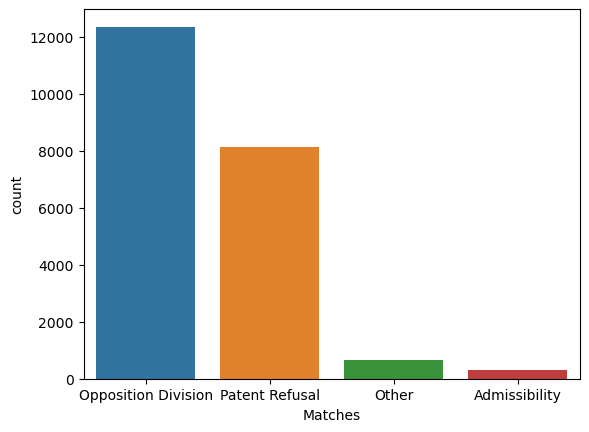

In [45]:
sns.countplot(data=t_df_clean,x='Matches')

In [46]:
#675 Other cases
t_df_clean.loc[t_df_clean['Matches']=='Other'].head()

,Reference,Procedure Language,Court Type,Appeal Number,Document Language,Summary Facts,Decision Reasons,Order,Date,ECLI,Invention Title,Board Code,Classification,Keywords,Year,nlp,Matches
2432,T000041EU1,en,T,0041,en,Summary of Facts and Submissions I. The appell...,Reasons for the Decision 1. The appeal is admi...,ORDER For these reasons it is decided that: 1....,2001-12-19,ECLI:EP:BA:2001:T004100.20011219,Optical inspection of container dimensional pa...,3.4.02,G01N 21/90,Incorrect assessment of prior art Third party'...,2001,"(Summary, of, Facts, and, Submissions, I., The...",Other
2524,T000148EU1,en,T,0148,en,Summary of Facts and Submissions I. European p...,Reasons for the Decision 1. The appeal is admi...,ORDER For these reasons it is decided that: 1....,2002-02-06,ECLI:EP:BA:2002:T014800.20020206,Structure for mounting an electrical module on...,3.4.02,H05K 3/36 H05K 1/14 H01R 23/70,Main request: clarity (yes) Subject-matter ext...,2002,"(Summary, of, Facts, and, Submissions, I., Eur...",Other
2660,T000301EU1,en,T,0301,en,Summary of Facts and Submissions I. The appeal...,Reasons for the Decision 1. The appeal is admi...,ORDER For these reasons it is decided that: 1....,2003-02-06,ECLI:EP:BA:2003:T030100.20030206,Method of making a heat treated coated glass,3.3.05,C03C 17/34,NaN,2003,"(Summary, of, Facts, and, Submissions, I., The...",Other
2703,T000352EU1,en,T,0352,en,Summary of Facts and Submissions I. The appeal...,Reasons for the Decision 1. The appeal is admi...,ORDER For these reasons it is decided that: 1....,2003-03-21,ECLI:EP:BA:2003:T035200.20030321,Layer structure having contact hole for fin-sh...,3.4.03,H01L 27/108,Inventive step (yes),2003,"(Summary, of, Facts, and, Submissions, I., The...",Other
2782,T000447EU1,en,T,0447,en,Summary of Facts and Submissions I. This is an...,Reasons for the Decision 1. Consolidation of a...,Order For these reasons it is decided that: Th...,2001-07-26,ECLI:EP:BA:2001:T044700.20010726,STILLAGE FOR STORING DRUMS,3.4.01,G21F 5/14,Restitutio - all due care - no Supervision of ...,2001,"(Summary, of, Facts, and, Submissions, I., Thi...",Other


In [4]:
### read in prev data
t_df_clean = pd.read_pickle("EPO_Matched_Type")

KeyboardInterrupt: 

In [20]:
### chop off first 35 word as same for all cases
t_df_clean['New Summary Facts'] = t_df_clean['Summary Facts'].apply(lambda x: x[35:])

C:\Users\sgdbareh\AppData\Local\Temp\ipykernel_14576\195567569.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  t_df_clean['New Summary Facts'] = t_df_clean['Summary Facts'].apply(lambda x: x[35:])


### Opposition Division

In [62]:
opposition_df = t_df_clean.loc[t_df_clean['Matches'] == 'Opposition Division']

In [65]:
len(opposition_df) #12365
len(opposition_df['ECLI'].unique()) #12324

#41 non-unique cases lets see them
rows = opposition_df.loc[opposition_df.duplicated(subset=['ECLI'],keep=False)]

In [67]:
#remove duplicate cases using ECLI
opposition_df.drop_duplicates(subset=['ECLI'], keep='first',inplace=True)

C:\Users\sgdbareh\AppData\Local\Temp\ipykernel_11736\1202078385.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  opposition_df.drop_duplicates(subset=['ECLI'], keep='first',inplace=True)


In [69]:
matcher = Matcher(nlp.vocab)
# Add match ID "HelloWorld" with no callback and one pattern

Both = [{"LOWER": {'FUZZY':"patent"}},{"LOWER":'proprietor'},{"LOWER": "and"},{"OP":'{,5}'},{"LOWER": {"FUZZY": "opponent"}}]
Both2 = [{"LOWER":{"FUZZY":'proprietor'}},{'OP':'{,3}'},{"LOWER":'('},{"OP":'{,5}'},{"LOWER": {"FUZZY": "appellant"}},{"OP":'{,5}'},{"LOWER":')'},{"OP":'{,10}'},
         {"LOWER":{"FUZZY":'opponent'}},{'OP':'{,3}'},{"LOWER":'('},{"OP":'{,5}'},{"LOWER": {"FUZZY": "appellant"}},{"OP":'{,5}'},{"LOWER":')'}]
Both3 = [{"LOWER":{'FUZZY':"opponent"}},{'OP':'{,3}'},{'LOWER':{'FUZZY':"proprietor"}},{'LOWER':{'FUZZY':"appeal"}}]

matcher.add("3", [Both,Both2,Both3])

Opponent = [{"LOWER": {'FUZZY':"appellant"}},{"OP":'{,3}'},{"LOWER": "("},{"OP":'{,5}'},{"LOWER": {"FUZZY": "opponent"}},{"OP":'{,5}'},{"LOWER":')'}]
Opponent2 = [{"LOWER":{'FUZZY':'opponent'}},{'OP':'{,3}'},{"LOWER":'('},{"OP":'{,5}'},{"LOWER": {"FUZZY": "appellant"}},{"OP":'{,3}'},{"LOWER":')'}]
Opponent3 = [{"LOWER":{'FUZZY':'opponent'}},{'OP':'{,3}'},{"LOWER": {"FUZZY": "appeal"}}]
Opponent4 = [{"LOWER":{'FUZZY':'appeal'}},{'lower':'of'},{"LOWER": {"FUZZY": "opponent"}}]


matcher.add("2", [Opponent,Opponent2,Opponent3,Opponent4])

Patentee = [{"LOWER": {'FUZZY':"appellant"}},{"OP":'{,3}'},{"LOWER": "("},{"OP":'{,5}'},{"LOWER": {"FUZZY": "patent"}},{"OP":'{,3}'},{"LOWER":')'}]
Patentee2 = [{"LOWER":{'FUZZY':'proprietor'}},{'OP':'{,3}'},{"LOWER":'('},{"OP":'{,5}'},{"LOWER": {"FUZZY": "appellant"}},{"OP":'{,3}'},{"LOWER":')'}]
Patentee3 = [{"LOWER": {'FUZZY':"appellant"}},{"OP":'{,3}'},{"LOWER": "("},{"OP":'{,5}'},{"LOWER": {"FUZZY": "proprietor"}},{"OP":'{,3}'},{"LOWER":')'}]
Patentee4 = [{"LOWER":{'FUZZY':'patent'}},{'OP':'{,3}'},{"LOWER":'('},{"OP":'{,5}'},{"LOWER": {"FUZZY": "appellant"}},{"OP":'{,3}'},{"LOWER":')'}]
Patentee5 = [{"LOWER":{'FUZZY':'proprietor'}},{'OP':'{,3}'},{"LOWER": {"FUZZY": "appeal"}}]
Patentee6 = [{"LOWER":{'FUZZY':'appeal'}},{"LOWER":'by'},{"LOWER":'the'},{"LOWER": {"FUZZY": "proprietor"}}]

matcher.add("1", [Patentee,Patentee2,Patentee3,Patentee4,Patentee5,Patentee6])



In [84]:
def get_matches_opposition(x,matcher):

    match = matcher(x)

    if match != []:

        string_ids = []
        spans=[]
        
        for match_id, start, end in match:
            string_ids.append(nlp.vocab.strings[match_id])  # Get string representation
            spans.append(x[start:end].text)  # The matched span
            #print(match_id, string_id, start, end, span.text)
        
        if "3" in string_ids:
            return "3"
        
        elif "2" in string_ids and "1" in string_ids:
            return "3"
        
        elif "2" in string_ids:
            return "2"
        
        elif "1" in string_ids:
            return "1"
    
    else:
        return 'Other'

In [19]:
#prev sets for determining keywords
test_sample = opposition_df.sample(n=50, random_state=42)
general_sample = opposition_df.sample(n=20, random_state=99)

In [75]:
#test sample for Opposition Division Category and Outcome
test_sample = opposition_df.sample(n=50, random_state=124)
test_sample['Matches'] = test_sample['nlp'].apply(lambda x : get_matches_opposition(x,matcher))
test_sample.to_excel('OP_Test_50.xlsx')

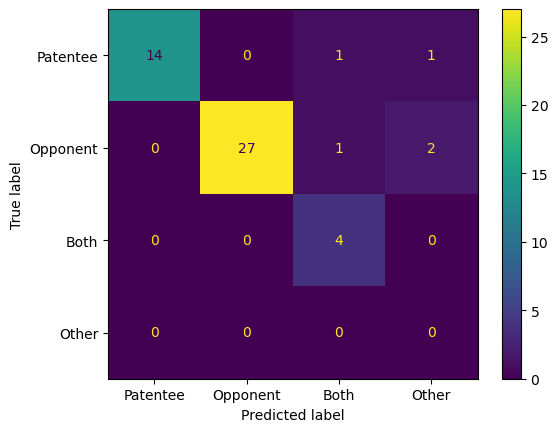

In [79]:
### Opposition Division - Case Type confusion matrix

### Patentee
### Opponent
### Both
### Other

from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

TypeTest = pd.read_excel('OP_Test_50.xlsx')

disp = ConfusionMatrixDisplay(confusion_matrix=confusion_matrix(TypeTest['REAL'],TypeTest['Matches']),
                               display_labels=['Patentee','Opponent','Both','Other'])

disp.plot()

In [85]:
opposition_df['Matches'] = opposition_df['nlp'].apply(lambda x : get_matches_opposition(x,matcher))

C:\Users\sgdbareh\AppData\Local\Temp\ipykernel_11736\423798327.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  opposition_df['Matches'] = opposition_df['nlp'].apply(lambda x : get_matches_opposition(x,matcher))


<Axes: xlabel='Matches', ylabel='count'>

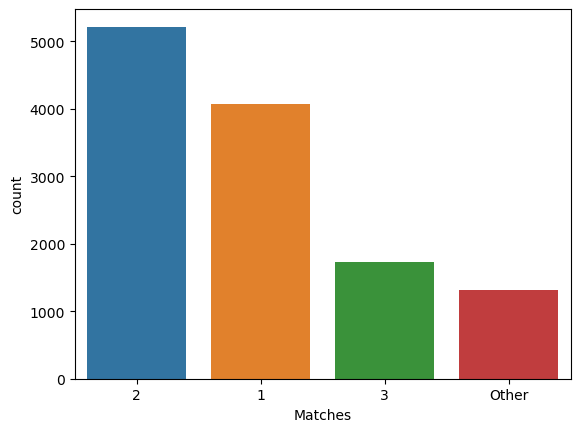

In [86]:
sns.countplot(data=opposition_df,x='Matches')

In [135]:
opposition_df_clean = opposition_df.loc[(opposition_df['Matches'] == '1') | (opposition_df['Matches'] == '2')]

<Axes: xlabel='Matches', ylabel='count'>

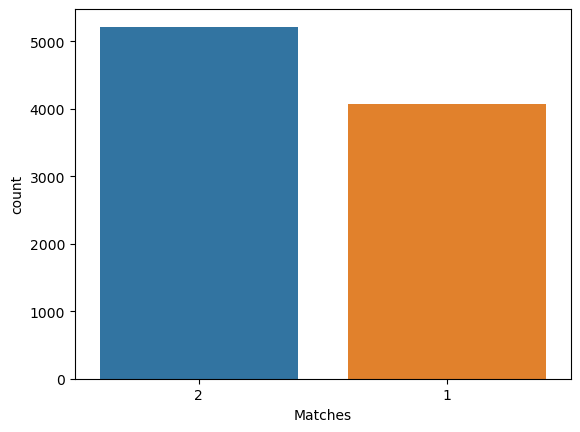

In [114]:
sns.countplot(data=opposition_df_clean,x='Matches')

In [25]:
def PreProcessingOutcome(df,nlp):
    
    #convert col to string
    df['Order'] = df['Order'].astype(str)
    #remove html tags
    df['nlp'] = df['Order'].apply(RemoveHTMLTags)
    #create spacy doc
    df["nlp"] = [doc for doc in nlp.pipe(df['nlp'].tolist())]
    #lowercase and alpha/ punctuation/ removes individual letters such as 'f' present in original text due to abbrev
    #df['nlp'] = [[tok.lower_ for tok in doc if (tok.is_alpha) and (len(tok)>1) or (tok.lower_ in ['a','i'])] for doc in df['nlp']]
    
    return df

In [28]:
def get_matches_outcome(x,matcher):

    match = matcher(x)

    if match != []:

        string_ids = []
        spans=[]
        
        for match_id, start, end in match:
            string_ids.append(nlp.vocab.strings[match_id])  # Get string representation
            spans.append(x[start:end].text)  # The matched span
            #print(match_id, string_id, start, end, span.text)
        
        if "Affirmed" in string_ids:
            return "Affirmed"
        
        elif "Reversed" in string_ids:
            return "Reversed"
        
    else:
        return 'Unknown'

In [31]:
#OUTCOME EXTRACTION - PATENT REFUSAL

matcher = Matcher(nlp.vocab)

DismissedPattern = [{"LOWER":{"FUZZY": "appeal"}},{'OP':'*'},{"LOWER": "dismissed"}]
RejectedPattern = [{"LOWER":{"FUZZY": "appeal"}},{'OP':'*'},{"LOWER": "rejected"}]

matcher.add("Affirmed",[DismissedPattern,RejectedPattern])

SetAsidePattern = [{"LOWER":{"FUZZY": "appeal"}},{'OP':'*'},{"LOWER": "set"},{"LOWER": "aside"}]

matcher.add("Reversed",[SetAsidePattern])


In [136]:
#Outcome identification

opposition_df_clean = PreProcessingOutcome(opposition_df_clean,nlp)

C:\Users\sgdbareh\AppData\Local\Temp\ipykernel_11736\637415169.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Order'] = df['Order'].astype(str)
C:\Users\sgdbareh\AppData\Local\Temp\ipykernel_11736\637415169.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['nlp'] = df['Order'].apply(RemoveHTMLTags)
C:\Users\sgdbareh\AppData\Local\Temp\ipykernel_11736\637415169.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexe

In [171]:
#test sample for outcome PATENT REFUSAL
#test_sample = opposition_df_clean.sample(n=50, random_state=124) - original testing and tweaking
test_sample = opposition_df_clean.sample(n=50, random_state=166)
test_sample['MatchesOutcome'] = test_sample['nlp'].apply(lambda x : get_matches_outcome(x,matcher))
test_sample.to_excel('OP_Outcome_Test_50.xlsx')

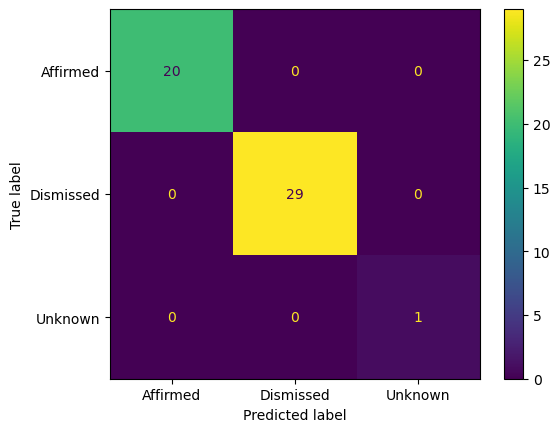

In [174]:
### Opposition Division - Case Outcome confusion matrix

### Affirmed
### Dismissed
### Unknown

from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

TypeTest = pd.read_excel('OP_Outcome_Test_50.xlsx')

disp = ConfusionMatrixDisplay(confusion_matrix=confusion_matrix(TypeTest['REAL'],TypeTest['MatchesOutcome']),
                               display_labels=['Affirmed','Dismissed','Unknown'])

disp.plot()

In [178]:
opposition_df_clean['Outcome'] = opposition_df_clean['nlp'].apply(lambda x : get_matches_outcome(x,matcher))

C:\Users\sgdbareh\AppData\Local\Temp\ipykernel_11736\3925039422.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  opposition_df_clean['Outcome'] = opposition_df_clean['nlp'].apply(lambda x : get_matches_outcome(x,matcher))


<Axes: xlabel='Outcome', ylabel='count'>

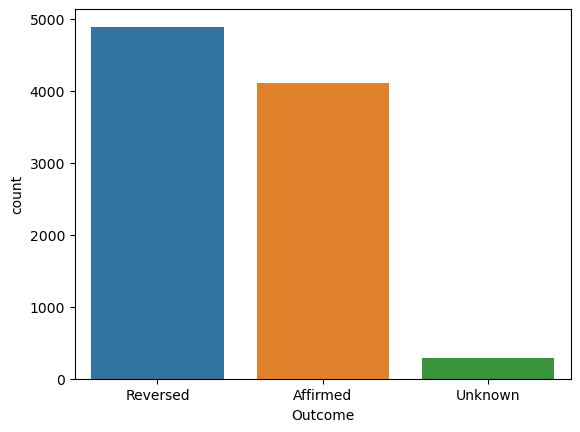

In [183]:
sns.countplot(data = opposition_df_clean, x='Outcome' )

In [184]:
opposition_binary = opposition_df_clean.loc[opposition_df_clean['Outcome'] != 'Unknown']

In [185]:
len(opposition_binary) #8998 cases 

8998

In [186]:
opposition_binary.to_pickle('Train&TestData_1.0_OppositionDivision')

### Patent Refusal

In [21]:
#Subset to patent refusal cases
refusal_df = t_df_clean.loc[t_df_clean['Matches'] == 'Patent Refusal']

In [22]:
len(refusal_df) #8148
len(refusal_df['ECLI'].unique()) #8121

#27 non-unique cases lets see them
rows = refusal_df.loc[refusal_df.duplicated(subset=['ECLI'],keep=False)]

In [23]:
#pd.set_option('display.max_colwidth', 100)

#remove duplicate cases using ECLI
refusal_df.drop_duplicates(subset=['ECLI'], keep='first',inplace=True)

C:\Users\sgdbareh\AppData\Local\Temp\ipykernel_14576\3878900649.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  refusal_df.drop_duplicates(subset=['ECLI'], keep='first',inplace=True)


In [26]:
refusal_df_outcome_clean = PreProcessingOutcome(refusal_df,nlp)

C:\Users\sgdbareh\AppData\Local\Temp\ipykernel_14576\637415169.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Order'] = df['Order'].astype(str)
C:\Users\sgdbareh\AppData\Local\Temp\ipykernel_14576\637415169.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['nlp'] = df['Order'].apply(RemoveHTMLTags)
C:\Users\sgdbareh\AppData\Local\Temp\ipykernel_14576\637415169.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexe

In [169]:
#test sample for outcome PATENT REFUSAL
test_sample = refusal_df_outcome_clean.sample(n=50, random_state=124)
test_sample['Matches'] = test_sample['nlp'].apply(lambda x : get_matches_outcome(x,matcher))
test_sample.to_excel('PF_Outcome_Test_50.xlsx')

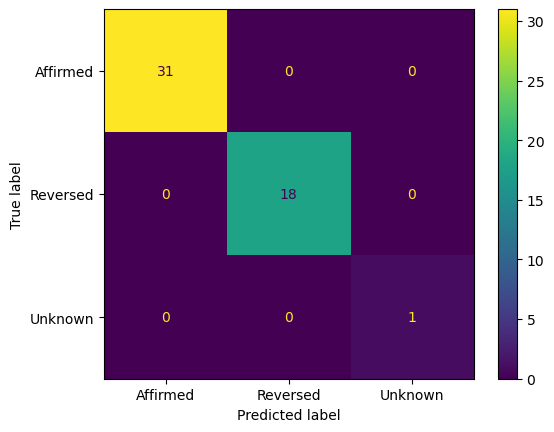

In [61]:
### Patent Refusal - Outcome Type confusion matrix

### Affirmed
### Reversed
### Unknown

from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

TypeTest = pd.read_excel('PF_Outcome_Test_50.xlsx')

disp = ConfusionMatrixDisplay(confusion_matrix=confusion_matrix(TypeTest['REAL'],TypeTest['Matches']),
                               display_labels=['Affirmed','Reversed','Unknown'])

disp.plot()

In [32]:
refusal_df_outcome_clean['Outcome'] = refusal_df_outcome_clean['nlp'].apply(lambda x : get_matches_outcome(x,matcher))

C:\Users\sgdbareh\AppData\Local\Temp\ipykernel_14576\2319024244.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  refusal_df_outcome_clean['Outcome'] = refusal_df_outcome_clean['nlp'].apply(lambda x : get_matches_outcome(x,matcher))


Text(0, 0.5, 'Number of Decisions')

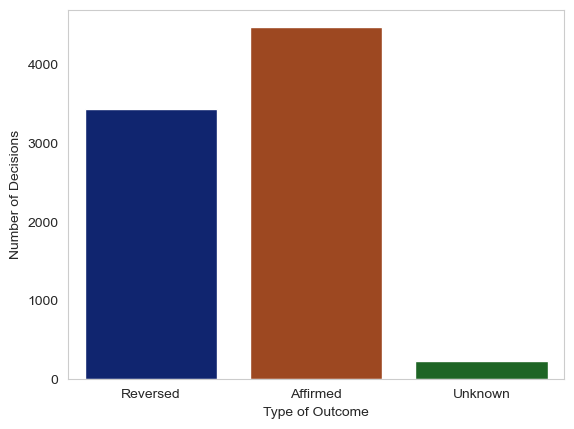

In [33]:
sns.set_style('whitegrid', {'axes.grid' : False})
sns.countplot(data = refusal_df_outcome_clean, x='Outcome',palette="dark" )
plt.xlabel('Type of Outcome')
plt.ylabel('Number of Decisions')

In [58]:
binary_refusal_df = refusal_df_outcome_clean.loc[refusal_df_outcome_clean['Outcome'] != 'Unknown']

In [59]:
len(binary_refusal_df) #7856 cases 

7856

In [ ]:
binary_refusal_df.to_pickle('Train&TestData_1.0_PatentRefusal')

## PATENT REFUSAL

In [309]:
binary_refusal_df = pd.read_pickle('Train&TestData_1.0_PatentRefusal')

In [311]:
affirmed_len = len(binary_refusal_df.loc[binary_refusal_df['Outcome'] == 'Affirmed'])
reversed_len = len(binary_refusal_df.loc[binary_refusal_df['Outcome'] == 'Reversed'])
total = affirmed_len + reversed_len
pct_affirmed = (affirmed_len/total)*100
pct_reversed = 100 - pct_affirmed 

print(pct_affirmed)
print(pct_reversed)

56.351832993890014
43.648167006109986


### EXPERIMENT 1 Data Processing

In [101]:
def pre_processing_experiments(df,opposition=False, experiment= '1',year_start=2019, year_stop=2020):

    if experiment == '2':

        test = df[(df['Year']>= year_start) & (df['Year']<= year_stop)]
        df = df.drop(test.index)

    affirmed_len = len(df.loc[df['Outcome'] == 'Affirmed'])
    reversed_len = len(df.loc[df['Outcome'] == 'Reversed']) 

    total = affirmed_len + reversed_len

    pct_affirmed = (affirmed_len/total)*100
    pct_reversed = 100 - pct_affirmed

    length_difference = affirmed_len - reversed_len 

    if length_difference < 0: 
        length_difference = length_difference * -1 
        test_sample = df.loc[df['Outcome'] == 'Reversed'].sample(n=length_difference, random_state=42)
    else:
        test_sample = df.loc[df['Outcome'] == 'Affirmed'].sample(n=length_difference, random_state=42)
    
    new_data = df.drop(test_sample.index)

    if experiment == '2':
        new_data = new_data.sort_values('Year')

    print(f"Length of dataset after balancing: {len(new_data)}")

    if opposition is True:
        X = new_data[['New Summary Facts','Matches']]
        dummies = pd.get_dummies(X['Matches'])
        dummies= (dummies == True).astype(int)
        X = pd.concat([X,dummies],axis=1)
        X.drop('Matches',axis=1,inplace=True)

    else:
        X = new_data['New Summary Facts']

    y = new_data['Outcome']

    if experiment == '2':
        X_train = X
        y_train = y

        if opposition is True:
            X_test = test[['New Summary Facts','Matches']]
            dummies = pd.get_dummies(X_test['Matches'])
            dummies= (dummies == True).astype(int)
            X_test = pd.concat([X_test,dummies],axis=1)
            X_test.drop('Matches',axis=1,inplace=True)

        else:
            X_test = test['New Summary Facts']

        y_test = test['Outcome']

    else:
        #90/10 split
        X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                    stratify=y, 
                                                    test_size=0.10,
                                                    random_state=42)
    
    if experiment == '1':

        if opposition is True:
            x_test_2 = test_sample[['New Summary Facts','Matches']]
            dummies = pd.get_dummies(x_test_2['Matches'])
            x_test_2 = pd.concat([x_test_2,dummies],axis=1)
            x_test_2.drop('Matches',axis=1,inplace=True)
        
        else:
            x_test_2 = test_sample['New Summary Facts']
        
        y_test_2 = test_sample['Outcome']

        X_test = pd.concat([X_test,x_test_2],axis=0)
        y_test = pd.concat([y_test,y_test_2],axis=0)

    if experiment == '1':
        test_split = pd.concat([X_test,y_test],axis=1)
        affirm = len(test_split.loc[test_split['Outcome'] == 'Affirmed'])
        reverse = len(test_split.loc[test_split['Outcome'] == 'Reversed'])

        if affirm< reverse:
            sample = round((affirm/pct_affirmed) * pct_reversed)
            new_test_split = test_split.loc[df['Outcome'] == 'Reversed'].sample(n=(reverse - sample), random_state=42)
        else:
            sample = round((reverse/pct_reversed) * pct_affirmed)
            new_test_split = test_split.loc[df['Outcome'] == 'Affirmed'].sample(n=(affirm - sample), random_state=42)

        test_split = test_split.drop(new_test_split.index)

        affirm = len(test_split.loc[test_split['Outcome'] == 'Affirmed'])
        reverse = len(test_split.loc[test_split['Outcome'] == 'Reversed'])

        X_test = test_split.loc[:,test_split.columns != 'Outcome']

        y_test = test_split['Outcome']

    X_train = pd.DataFrame(X_train)
    X_test = pd.DataFrame(X_test)

    X_train['New Summary Facts'] = X_train['New Summary Facts'].apply(RemoveHTMLTags)
    X_test['New Summary Facts'] = X_test['New Summary Facts'].apply(RemoveHTMLTags)

    y_train_processed = [1 if i == 'Affirmed' else 0 for i in y_train]
    y_test_processed  = [1 if i == 'Affirmed' else 0 for i in y_test]

    y_train_processed = pd.DataFrame(y_train_processed)
    y_test_processed = pd.DataFrame(y_test_processed)


    if opposition == True:
        name = 'op'

    else:
        name = 'pf'

    if experiment == '2':
        year = f'{year_start}_{year_stop}'

    else:
        year = ''

    #ENABLE
    X_train.to_pickle(f'X_Train_{experiment}_{name}')
    y_train_processed.to_pickle(f'y_Train_{experiment}_{name}')
    X_test.to_pickle(f'X_test_{experiment}_{name}{year}')
    y_test_processed.to_pickle(f'y_test_{experiment}_{name}{year}')

    return X_train, y_train, X_test, y_test

In [56]:
def plot_binary_dist(y_train,y_test):

    #make better for both sides

    fig, axs = plt.subplots(ncols=2)
    sns.countplot(data = pd.DataFrame(y_train),x='Outcome',ax=axs[0])
    sns.countplot(data = pd.DataFrame(y_test),x='Outcome',ax=axs[1])

In [102]:
X_train, y_train, X_test, y_test = pre_processing_experiments(binary_refusal_df,opposition=False,experiment='1')

Length of dataset after balancing: 6858


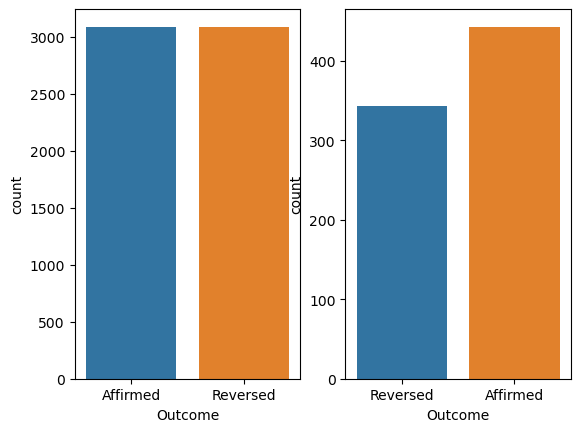

In [103]:
plot_binary_dist(y_train,y_test)

In [36]:
x = pd.read_pickle('y_test_2_pf2019_2022')

In [37]:
x.value_counts()

1    954
0    552
Name: count, dtype: int64

### Experiment 2 Data Processing

In [104]:
data = pd.read_pickle('Train&TestData_1.0_PatentRefusal')

<Axes: xlabel='Year', ylabel='count'>

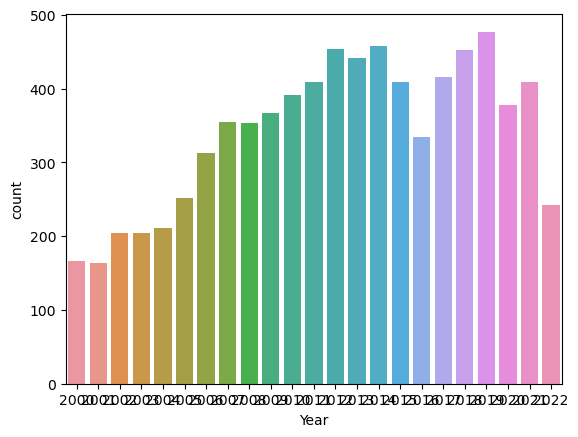

In [72]:
sns.countplot(data=data, x=data['Year'])

In [107]:
X_train, y_train, X_test, y_test = pre_processing_experiments(data,opposition=False,experiment='2',year_start=2019, year_stop=2022) 

Length of dataset after balancing: 5754


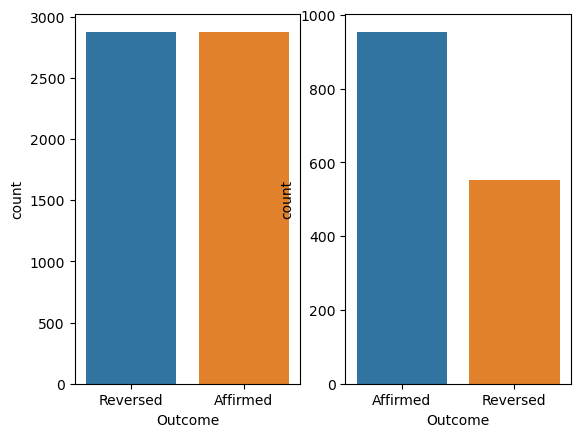

In [108]:
plot_binary_dist(y_train,y_test)

## OPPOSITION DIVISION

In [58]:
opposition_df = pd.read_pickle('Train&TestData_1.0_OppositionDivision')

### Experiment 1 Data Processsing

In [109]:
X_train, y_train, X_test, y_test = pre_processing_experiments(opposition_df,opposition=True,experiment='1')

Length of dataset after balancing: 8220


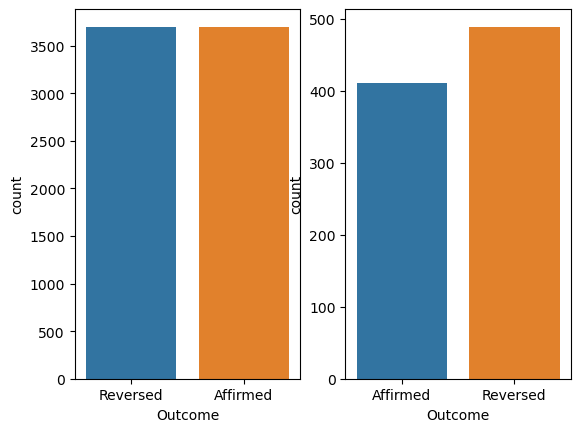

In [110]:
plot_binary_dist(y_train,y_test)

### Experimemt 2 Data Processing

<Axes: xlabel='Year', ylabel='count'>

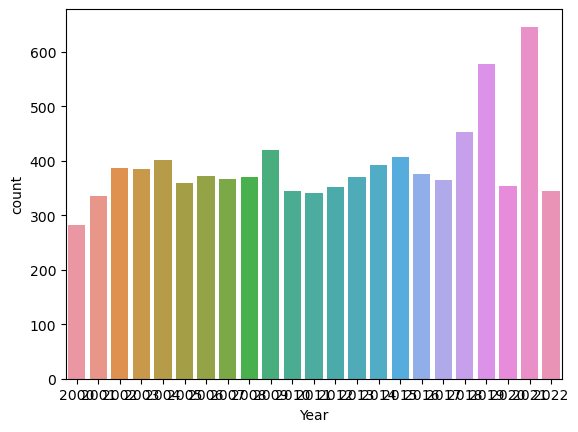

In [78]:
sns.countplot(data=opposition_df, x=opposition_df['Year'])

In [113]:
X_train, y_train, X_test, y_test = pre_processing_experiments(opposition_df,opposition=True,experiment='2',year_start=2019, year_stop=2022)

Length of dataset after balancing: 6564


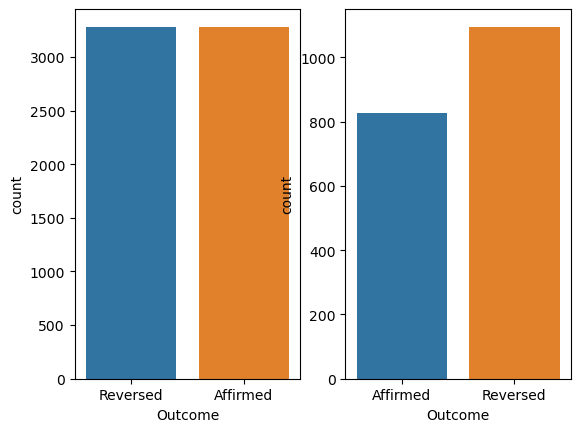

In [114]:
plot_binary_dist(y_train,y_test)

## RESULTS

### Pre-Process Results

In [204]:
op_n = pd.read_pickle('Op_div_1_0_10_FOLD_!_N_GRAM')
op_tf = pd.read_pickle('Op_div_1_1_10_FOLD_!_TF')
op_we = pd.read_pickle('Op_div_1_5_10_FOLD_!_True_we')

op_tf.reset_index(inplace=True)
op_tf = op_tf.assign(Algo = pd.Series(['LinearSVC', 'LogisticReg', 'RandomForest','XGBoost']))
op_n.reset_index(inplace=True)
op_n = op_n.assign(Algo = pd.Series(['LinearSVC', 'LogisticReg', 'RandomForest','XGBoost']))
op_we.reset_index(inplace=True)
op_we = op_we.assign(Algo = pd.Series(['LinearSVC', 'LogisticReg', 'RandomForest','XGBoost','LogisticReg', 'RandomForest','XGBoost','LogisticReg','RandomForest','XGBoost','LogisticReg','XGBoost']))
op_n = op_n.set_index('Algo')
op_tf = op_tf.set_index('Algo')
op_we = op_we.set_index('Algo')

op_tf

op_we.drop(['N_Grams', 'TF-IDF', 'index'],axis=1, inplace=True)
op_n.drop(['index'],axis=1, inplace=True)
op_tf.drop(['index'],axis=1, inplace=True)

op_we = op_we.groupby(['Algo']).first()

x = pd.merge(op_n,op_tf, on='Algo')

op_1 = pd.merge(x,op_we, on='Algo')

for i in range(len(inputs)):
    x = list(op_1.iloc[0][i]['params'])
    y = inputs[i]
    op_1[f'{y}_Param'] = x


for i in range(len(inputs)):

    for j in range(4):

        op_1.iloc[j][i]['params'] = 0

In [344]:
op_2 = pd.read_pickle('Op_div_2_5_10_FOLD_!_')
op_2.reset_index(inplace=True)
op_2 = op_2.assign(Algo = pd.Series(['LinearSVC', 'LogisticReg', 'RandomForest','XGBoost','LinearSVC', 'LogisticReg', 'RandomForest','XGBoost','LinearSVC', 'LogisticReg', 'RandomForest','XGBoost','LogisticReg','XGBoost','LinearSVC', 'LogisticReg', 'XGBoost','LogisticReg']))
op_2.drop(['index'],axis=1,inplace=True)
op_2 = op_2.groupby(['Algo']).first()

for i in range(len(inputs)):
    x = list(op_2.iloc[0][i]['params'])
    y = inputs[i]
    op_2[f'{y}_Param'] = x


for i in range(len(inputs)):

    for j in range(4):

        op_2.iloc[j][i]['params'] = 0

In [34]:
#pat_n = pd.read_pickle('Pat_1_0_10_FOLD_!_Ngram')
pat_tf = pd.read_pickle('Pat_1_1_10_FOLD_!_TF')
pat_we = pd.read_pickle('Pat_1_5_10_FOLD_!_True')

pat_tf.reset_index(inplace=True)
pat_tf = pat_tf.assign(Algo = pd.Series(['LinearSVC', 'LogisticReg', 'RandomForest','XGBoost','LogisticReg', 'RandomForest','XGBoost']))
pat_we.reset_index(inplace=True)
pat_we = pat_we.assign(Algo = pd.Series(['LinearSVC', 'LogisticReg', 'RandomForest','XGBoost','LogisticReg', 'RandomForest','XGBoost','LogisticReg','RandomForest','LogisticReg','XGBoost']))
pat_tf = pat_tf.set_index('Algo')
pat_we = pat_we.set_index('Algo')

pat_tf = pat_tf.groupby(['Algo']).first()
pat_tf.drop(['index'],axis=1, inplace=True)
pat_we.drop(['N_Grams', 'TF-IDF', 'index'],axis=1, inplace=True)

pat_we = pat_we.groupby(['Algo']).first()

pat_1 = pd.merge(pat_tf,pat_we, on='Algo')

inputs = ['N_Grams','TF_IDF', 'word2vec', 'patent2vec', 'law2vec', 'doc2vec']

for i in range(len(inputs)):
    x = list(pat_1.iloc[0][i]['params'])
    y = inputs[i]
    pat_1[f'{y}_Param'] = x


for i in range(len(inputs)):

    for j in range(4):

        pat_1.iloc[j][i]['params'] = 0


In [35]:
pat_2 = pd.read_pickle('Pat_2_3cv_RESULTS.pkl_10_FOLD_!!!!')
pat_2.reset_index(inplace=True)
pat_2 = pat_2.assign(Algo = pd.Series(['LinearSVC', 'LogisticReg', 'RandomForest','XGBoost','LinearSVC', 'LogisticReg', 'RandomForest','XGBoost', 'LogisticReg', 'RandomForest','LinearSVC','XGBoost','LogisticReg', 'RandomForest','XGBoost','LogisticReg']))
pat_2.drop(['index'],axis=1,inplace=True)
pat_2 = pat_2.groupby(['Algo']).first()

for i in range(len(inputs)):
    x = list(pat_2.iloc[0][i]['params'])
    y = inputs[i]
    pat_2[f'{y}_Param'] = x

for i in range(len(inputs)):

    for j in range(4):

        pat_2.iloc[j][i]['params'] = 0


In [303]:
def weighted_average(num_weights):

    weights = [i / num_weights for i in range(1, num_weights + 1)]

    xy = np.array(weights)
    
    w_a = xy/sum(xy)

    return w_a

In [296]:
w_a = weighted_average(5754)
print(w_a)

[ 579 1154 1730 2305 2881 3456 4031 4607 5182 5758]
[0.01827478 0.03642332 0.05460342 0.07275195 0.09093205 0.10908058
 0.12722911 0.14540921 0.16355774 0.18173784]


In [304]:
w_a = weighted_average(10)
print(w_a)

[0.01818182 0.03636364 0.05454545 0.07272727 0.09090909 0.10909091
 0.12727273 0.14545455 0.16363636 0.18181818]


In [302]:
w_a = weighted_average(10)
print(w_a)

[0.1 0.2 0.3 0.4 0.5 0.6 0.7 0.8 0.9 1. ]
[0.01818182 0.03636364 0.05454545 0.07272727 0.09090909 0.10909091
 0.12727273 0.14545455 0.16363636 0.18181818]


In [305]:
def extract_info(results, exp_2=False, weights=10):

    final_results = pd.DataFrame()

    results_copy = results.copy()

    for clf in range(len(results)):

        for input in range(6):

            data = pd.DataFrame(results.iloc[clf][input])

            acc = data.loc[:,'test_Accuracy'].mean() *100
            acc_std = (data.loc[:,'test_Accuracy'] *100).std()
            f1 = data.loc[:,'test_F1'].mean() *100
            f1_std = (data.loc[:,'test_F1'] *100).std()
            mcc = data.loc[:,'test_MCC'].mean() *100
            mcc_std = (data.loc[:,'test_MCC'] *100).std() 
            input_data = results.iloc[clf].index[input]

            if clf == 0:
                algo = 'SVM'
            elif clf == 1:
                algo = 'LR'            
            elif clf == 2:
                algo = 'RF'
            else:
                algo = 'XGB'
            
            if exp_2 is True:

                w_a = weighted_average(weights)
                
                w_s = DescrStatsW(np.array(data.loc[:,'test_Accuracy']*100),weights=w_a)

                acc_w = w_s.mean
                acc_w_std = w_s.std

                w_s_f1 = DescrStatsW(np.array(data.loc[:,'test_F1']*100),weights=w_a)

                f1_w = w_s_f1.mean
                f1_w_std = w_s_f1.std

                w_s_mcc = DescrStatsW(np.array(data.loc[:,'test_MCC']*100),weights=w_a)

                mcc_w = w_s_mcc.mean
                mcc_w_std = w_s_mcc.std

                final_results = pd.concat([final_results, pd.DataFrame([{'algo':algo, 'input':input_data, 'acc_w':acc_w, 'acc_w_std':acc_w_std, 'f1':f1_w, 'f1_std':f1_w_std, 'mcc':mcc_w, 'mcc_std':mcc_w_std}])], ignore_index=True)

            else:
                final_results = pd.concat([final_results, pd.DataFrame([{'algo':algo, 'input':input_data, 'acc':acc, 'acc_std':acc_std, 'f1':f1, 'f1_std':f1_std, 'mcc':mcc, 'mcc_std':mcc_std}])], ignore_index=True)

    return final_results

    

In [307]:
pat_1_full = extract_info(pat_1)
pat_2_full = extract_info(pat_2,exp_2=True)
#op_1_full = extract_info(op_1)
#op_2_full = extract_info(op_2, exp_2=True,len_X=6564)

In [308]:
pat_2_full

,algo,input,acc_w,acc_w_std,f1,f1_std,mcc,mcc_std
0,SVM,N_Grams,84.230836,3.068137,85.139719,5.554504,67.764294,6.048204
1,SVM,TF-IDF,84.171736,3.467407,85.128184,5.875725,67.695934,6.668639
2,SVM,word2vec,68.173127,2.057986,70.114669,4.689386,35.532632,3.817086
3,SVM,patent2vec,71.201112,1.780450,73.541723,4.939465,41.069220,3.126578
4,SVM,law2vec,67.293586,1.743451,69.639308,5.329432,33.155285,2.720920
5,SVM,doc2vec,69.720146,2.023639,71.408090,5.004291,38.731581,4.132762
6,LR,N_Grams,84.498523,2.987346,85.430513,5.374178,68.307897,5.819838
7,LR,TF-IDF,84.418564,3.214982,85.268428,5.555806,68.191667,6.246871
8,LR,word2vec,68.795411,2.072015,70.651658,4.191759,36.780277,3.766086
9,LR,patent2vec,71.100295,1.678573,73.433101,4.796822,40.872755,2.991529


## Testing Models

### Confusion Matrices

In [516]:
X_train_1_pf = pd.read_pickle('X_Train_1_pf')
y_train_1_pf = pd.read_pickle('y_Train_1_pf')

X_test_1_pf = pd.read_pickle('X_test_1_pf')
y_test_1_pf = pd.read_pickle('y_test_1_pf')

#X_train_2_pf = pd.read_pickle('X_Train_2_pf')
#y_train_2_pf = pd.read_pickle('y_Train_2_pf')

#X_train_1_op = pd.read_pickle('X_Train_1_op')
#y_train_1_op = pd.read_pickle('y_Train_1_op')

#X_test_1_op = pd.read_pickle('X_test_1_op')
#y_test_1_op = pd.read_pickle('y_test_1_op')

#X_train_2_op = pd.read_pickle('X_Train_2_op')
#y_train_2_op = pd.read_pickle('y_Train_2_op')

In [472]:
from sklearn.metrics import matthews_corrcoef, accuracy_score, classification_report, confusion_matrix, precision_recall_fscore_support, ConfusionMatrixDisplay
from Classes import Experiments, TextProcess, Word2VecTransform
from sklearn.compose import ColumnTransformer
from sklearn.dummy import DummyClassifier
from sklearn.preprocessing import Binarizer

def evaluation(y_pred, y_test, X_test, X_train = 1, y_train= 1):

    print('Accuracy: ', accuracy_score(y_test, y_pred) )
    print('Classification report: ', classification_report(y_test, y_pred))
    print('CR: ', precision_recall_fscore_support(y_test, y_pred, average='macro'))
    print('MCC: ', matthews_corrcoef(y_test, y_pred))
    dummy_clf = DummyClassifier(strategy="most_frequent")
    dummy_clf.fit(X_test,y_test)
    print('Dummy: ',dummy_clf.score(X_test,y_test))
    y_pred2 = dummy_clf.predict(X_test)
    print(y_pred2)
    print('CR222: ', precision_recall_fscore_support(y_test, y_pred2, average='macro'))

    y_test = ['Affirmed' if i == 1 else 'Reversed' for i in y_test]
    y_pred = ['Affirmed' if i == 1 else 'Reversed' for i in y_pred]
    print('Confusion matrix: ')
    disp = ConfusionMatrixDisplay.from_predictions(y_test,y_pred,cmap='Blues',normalize='true')

    plt.show()



In [153]:
# Patent Ref Exp 1
steps_pf_1 = Pipeline([('pre_process',TextProcess(stopwords= False, numbers= False, lemmatisation= True)),('vect', TfidfVectorizer(tokenizer=lambda x:x,preprocessor=lambda x:x, use_idf=True, norm='l2', ngram_range=(1,4),min_df=5)), ('clf', xgb.XGBClassifier(random_state=42, objective='binary:logistic', num_boost_round=200, n_estimators=300, learning_rate=0.05, gamma=0.1))])

exp = Experiments(opposition=False)
exp.training_helper_preprocess(X_train_1_pf)

X_train_1_pf = exp.X_train
y_train_1_pf = y_train_1_pf[0].to_numpy()

In [154]:
steps_pf_1.fit(X_train_1_pf, y_train_1_pf)

exp.training_helper_preprocess(X_test_1_pf)

X_test_1_pf = exp.X_train
y_test_1_pf = y_test_1_pf[0].to_numpy()

y_pred_1_pf = steps_pf_1.predict(X_test_1_pf)

[11:47:14] WARNING: D:\bld\xgboost-split_1679035243975\work\src\learner.cc:767: 
Parameters: { "num_boost_round" } are not used.



Accuracy:  0.8524173027989822
Classification report:                precision    recall  f1-score   support

           0       0.81      0.86      0.84       343
           1       0.89      0.84      0.87       443

    accuracy                           0.85       786
   macro avg       0.85      0.85      0.85       786
weighted avg       0.85      0.85      0.85       786

CR:  (0.8496599746201152, 0.8536087766290006, 0.8509494664155681, None)
MCC:  0.7032576650461659
Dummy:  0.5636132315521628
[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 

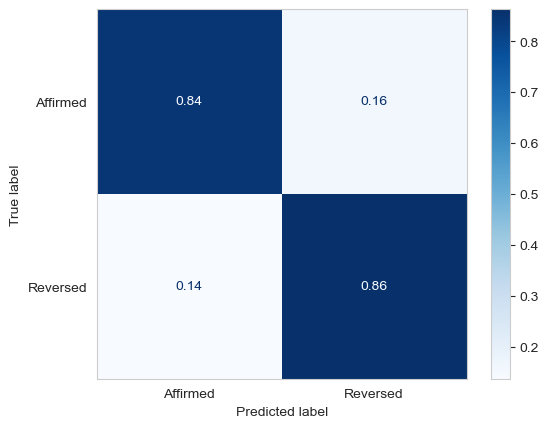

In [54]:
evaluation(y_pred_1_pf, y_test_1_pf, X_test_1_pf, X_train_1_pf, y_train_1_pf)

In [55]:
# Patent Ref Exp 2
steps_pf_2 = Pipeline([('pre_process',TextProcess(stopwords= True, numbers= True, lemmatisation= True)),('vect', TfidfVectorizer(tokenizer=lambda x:x,preprocessor=lambda x:x, use_idf=False, norm=None, ngram_range=(1,4),min_df=10)), ('clf', xgb.XGBClassifier(random_state=42, objective='binary:logistic', num_boost_round=300, n_estimators=300, learning_rate=0.05, gamma=0.2))])

exp = Experiments(opposition=False)
exp.training_helper_preprocess(X_train_2_pf)

X_train_2_pf = exp.X_train
y_train_2_pf = y_train_2_pf[0].to_numpy()

steps_pf_2.fit(X_train_2_pf, y_train_2_pf)

[13:24:48] WARNING: D:\bld\xgboost-split_1679035243975\work\src\learner.cc:767: 
Parameters: { "num_boost_round" } are not used.



Pipeline(steps=[('pre_process',
                 TextProcess(lemmatisation=True, numbers=True, stopwords=True)),
                ('vect',
                 TfidfVectorizer(min_df=10, ngram_range=(1, 4), norm=None,
                                 preprocessor=<function <lambda> at 0x000001758C52DEA0>,
                                 tokenizer=<function <lambda> at 0x000001758C52CDC0>,
                                 use_idf=False)),
                ('clf',
                 XGBClassifier(base_score=None, booster=None, callbacks=None,
                               colsample_byle...
                               grow_policy=None, importance_type=None,
                               interaction_constraints=None, learning_rate=0.05,
                               max_bin=None, max_cat_threshold=None,
                               max_cat_to_onehot=None, max_delta_step=None,
                               max_depth=None, max_leaves=None,
                               min_child_weight=None, missing=nan,
                               monotone_constraints=None, n_estimators=300,
                               n_jobs=None, num_boost_round=300,
                               num_parallel_tree=None, predictor=None, ...))])

In [56]:
X_test_2_pf2019_2020 = pd.read_pickle('X_test_2_pf2019_2020')
y_test_2_pf2019_2020 = pd.read_pickle('y_test_2_pf2019_2020')

X_test_2_pf2021_2022 = pd.read_pickle('X_test_2_pf2021_2022')
y_test_2_pf2021_2022 = pd.read_pickle('y_test_2_pf2021_2022')

X_test_2_pf2019_2022 = pd.read_pickle('X_test_2_pf2019_2022')
y_test_2_pf2019_2022 = pd.read_pickle('y_test_2_pf2019_2022')

In [57]:
#19-20

exp = Experiments(opposition=False)

exp.training_helper_preprocess(X_test_2_pf2019_2020)
X_test_2_pf2019_2020 = exp.X_train
y_test_2_pf2019_2020 = y_test_2_pf2019_2020[0].to_numpy()

y_pred_2_pf2019_2020 = steps_pf_2.predict(X_test_2_pf2019_2020)



Accuracy:  0.87953216374269
Classification report:                precision    recall  f1-score   support

           0       0.84      0.83      0.84       317
           1       0.90      0.91      0.90       538

    accuracy                           0.88       855
   macro avg       0.87      0.87      0.87       855
weighted avg       0.88      0.88      0.88       855

CR:  (0.871398801464615, 0.8699353840019701, 0.8706541391703593, None)
MCC:  0.7413327410486705
Dummy:  0.6292397660818714
[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1

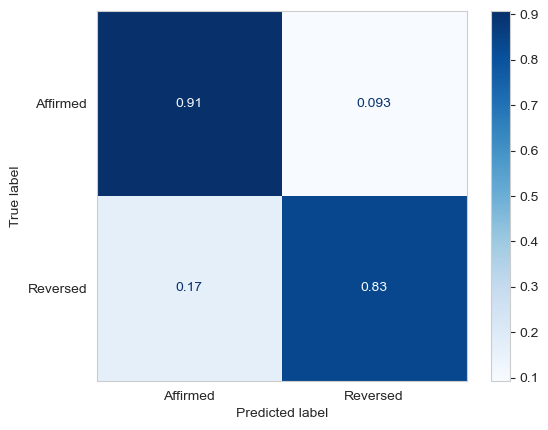

In [58]:
evaluation(y_pred_2_pf2019_2020, y_test_2_pf2019_2020, X_test_2_pf2019_2020, X_train_2_pf, y_train_2_pf)


Accuracy:  0.8448540706605223
Classification report:                precision    recall  f1-score   support

           0       0.77      0.82      0.79       235
           1       0.89      0.86      0.88       416

    accuracy                           0.84       651
   macro avg       0.83      0.84      0.83       651
weighted avg       0.85      0.84      0.85       651

CR:  (0.8303840399002493, 0.8387990998363339, 0.834064783151838, None)
MCC:  0.6691302274400579
Dummy:  0.6390168970814132
[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1

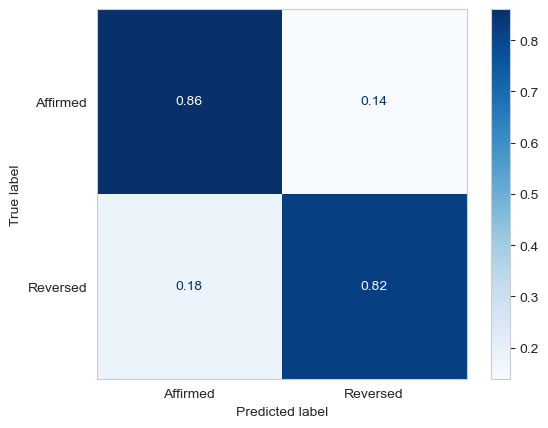

In [59]:
#21-22

exp = Experiments(opposition=False)

exp.training_helper_preprocess(X_test_2_pf2021_2022)
X_test_2_pf2021_2022 = exp.X_train
y_test_2_pf2021_2022 = y_test_2_pf2021_2022[0].to_numpy()

y_pred_2_pf2021_2022 = steps_pf_2.predict(X_test_2_pf2021_2022)

evaluation(y_pred_2_pf2021_2022, y_test_2_pf2021_2022, X_test_2_pf2021_2022, X_train_2_pf, y_train_2_pf)


Accuracy:  0.8645418326693227
Classification report:                precision    recall  f1-score   support

           0       0.81      0.83      0.82       552
           1       0.90      0.89      0.89       954

    accuracy                           0.86      1506
   macro avg       0.85      0.86      0.85      1506
weighted avg       0.87      0.86      0.86      1506

CR:  (0.8532999051361974, 0.856439704675964, 0.854804682183204, None)
MCC:  0.7097326647373424
Dummy:  0.6334661354581673
[1 1 1 ... 1 1 1]
CR222:  (0.31673306772908366, 0.5, 0.3878048780487805, None)
Confusion matrix: 


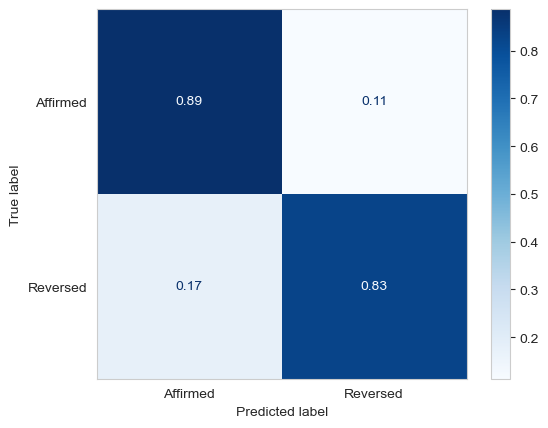

In [60]:
#19-22

exp = Experiments(opposition=False)

exp.training_helper_preprocess(X_test_2_pf2019_2022)
X_test_2_pf2019_2022 = exp.X_train
y_test_2_pf2019_2022 = y_test_2_pf2019_2022[0].to_numpy()

y_pred_2_pf2019_2022 = steps_pf_2.predict(X_test_2_pf2019_2022)

evaluation(y_pred_2_pf2019_2022, y_test_2_pf2019_2022, X_test_2_pf2019_2022, X_train_2_pf, y_train_2_pf)


In [658]:
# Op Div Exp 1
tp = TextProcess(stopwords= True, numbers= True, lemmatisation= True)

preprocessor = ColumnTransformer(transformers=[("num", TfidfVectorizer(tokenizer=lambda x:x,preprocessor=lambda x:x, use_idf=False, norm=None, ngram_range=(1,2),min_df=5),'New Summary Facts'),("Cats",Binarizer(),['1','2'])])
steps_op_1 = Pipeline([('vect', preprocessor), ('clf', xgb.XGBClassifier(random_state=42, objective='binary:logistic', num_boost_round=100, n_estimators=300, learning_rate=0.02, gamma=0.0))])

exp = Experiments(opposition=True)
exp.training_helper_preprocess(X_train_1_op)

X_train_1_op = exp.X_train
y_train_1_op = y_train_1_op[0].to_numpy()

X_train_1_op = X_train_1_op.copy()
X_train_1_op['New Summary Facts'] = tp.fit_transform(X_train_1_op['New Summary Facts'])                

steps_op_1.fit(X_train_1_op, y_train_1_op)

exp.training_helper_preprocess(X_test_1_op)

X_test_1_op = exp.X_train
y_test_1_op = y_test_1_op[0].to_numpy()

X_test_1_op = X_test_1_op.copy()
X_test_1_op['New Summary Facts'] = tp.fit_transform(X_test_1_op['New Summary Facts'])                

y_pred_1_op = steps_op_1.predict(X_test_1_op)

[15:35:30] WARNING: D:\bld\xgboost-split_1679035243975\work\src\learner.cc:767: 
Parameters: { "num_boost_round" } are not used.



Accuracy:  0.7866666666666666
Classification report:                precision    recall  f1-score   support

           0       0.85      0.73      0.79       489
           1       0.73      0.85      0.78       411

    accuracy                           0.79       900
   macro avg       0.79      0.79      0.79       900
weighted avg       0.80      0.79      0.79       900

CR:  (0.7910330010568674, 0.7918439239920588, 0.7866498093676537, None)
Confusion matrix: 
MCC:  0.5828763609535772
Dummy:  0.5433333333333333


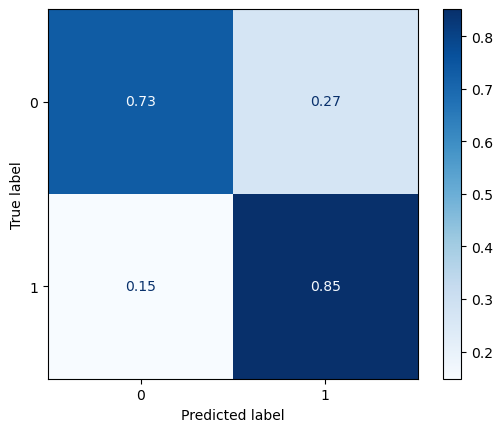

In [690]:
evaluation(y_pred_1_op, y_test_1_op, X_test_1_op, X_train_1_op, y_train_1_op)

In [659]:
# Op Div Exp 2
tp = TextProcess(stopwords= True, numbers= False, lemmatisation= False)

preprocessor = ColumnTransformer(transformers=[("num", TfidfVectorizer(tokenizer=lambda x:x,preprocessor=lambda x:x, use_idf=True, norm='l2', ngram_range=(1,4),min_df=10),'New Summary Facts'),("Cats",Binarizer(),['1','2'])])
steps_op_2 = Pipeline([('vect', preprocessor), ('clf', xgb.XGBClassifier(random_state=42, objective='binary:logistic', num_boost_round=100, n_estimators=300, learning_rate=0.05, gamma=0.0))])

exp = Experiments(opposition=True)
exp.training_helper_preprocess(X_train_2_op)

X_train_2_op = exp.X_train
y_train_2_op = y_train_2_op[0].to_numpy()

X_train_2_op = X_train_2_op.copy()
X_train_2_op['New Summary Facts'] = tp.fit_transform(X_train_2_op['New Summary Facts'])                

steps_op_2.fit(X_train_2_op, y_train_2_op)

[15:53:34] WARNING: D:\bld\xgboost-split_1679035243975\work\src\learner.cc:767: 
Parameters: { "num_boost_round" } are not used.



Pipeline(steps=[('vect',
                 ColumnTransformer(transformers=[('num',
                                                  TfidfVectorizer(min_df=10,
                                                                  ngram_range=(1,
                                                                               4),
                                                                  preprocessor=<function <lambda> at 0x0000021EFE0003A0>,
                                                                  tokenizer=<function <lambda> at 0x0000021EFE000790>),
                                                  'New Summary Facts'),
                                                 ('Cats', Binarizer(),
                                                  ['1', '2'])])),
                ('clf',
                 XGBClassifier(base_score=None, booster=None, callbacks=None,
                               colsample_bylevel=None,...
                               grow_policy=None, importance_type=None,
                               interaction_constraints=None, learning_rate=0.05,
                               max_bin=None, max_cat_threshold=None,
                               max_cat_to_onehot=None, max_delta_step=None,
                               max_depth=None, max_leaves=None,
                               min_child_weight=None, missing=nan,
                               monotone_constraints=None, n_estimators=300,
                               n_jobs=None, num_boost_round=100,
                               num_parallel_tree=None, predictor=None, ...))])

In [694]:
#import test data op div 2

X_test_2_op2019_2020 = pd.read_pickle('X_test_2_op2019_2020')
y_test_2_op2019_2020 = pd.read_pickle('y_test_2_op2019_2020')

X_test_2_op2021_2022 = pd.read_pickle('X_test_2_op2021_2022')
y_test_2_op2021_2022 = pd.read_pickle('y_test_2_op2021_2022')

X_test_2_op2019_2022 = pd.read_pickle('X_test_2_op2019_2022')
y_test_2_op2019_2022 = pd.read_pickle('y_test_2_op2019_2022')


Accuracy:  0.7929184549356223
Classification report:                precision    recall  f1-score   support

           0       0.84      0.78      0.81       522
           1       0.74      0.81      0.77       410

    accuracy                           0.79       932
   macro avg       0.79      0.79      0.79       932
weighted avg       0.80      0.79      0.79       932

CR:  (0.7909522821098273, 0.794724792075507, 0.7915687040193559, None)
Confusion matrix: 
MCC:  0.5856649241629999
Dummy:  0.5600858369098712


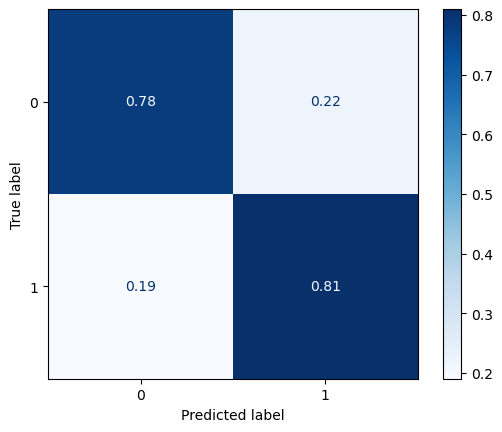

In [695]:
#19-20

tp = TextProcess(stopwords= True, numbers= False, lemmatisation= False)

exp = Experiments(opposition=True)
exp.training_helper_preprocess(X_test_2_op2019_2020)

X_test_2_op2019_2020 = exp.X_train
y_test_2_op2019_2020 = y_test_2_op2019_2020[0].to_numpy()

X_test_2_op2019_2020 = X_test_2_op2019_2020.copy()
X_test_2_op2019_2020['New Summary Facts'] = tp.fit_transform(X_test_2_op2019_2020['New Summary Facts'])                

y_pred_2_op2019_2020 = steps_op_2.predict(X_test_2_op2019_2020)

evaluation(y_pred_2_op2019_2020, y_test_2_op2019_2020, X_test_2_op2019_2020, X_train_2_op, y_train_2_op)

Accuracy:  0.8082744702320888
Classification report:                precision    recall  f1-score   support

           0       0.85      0.82      0.83       573
           1       0.76      0.80      0.78       418

    accuracy                           0.81       991
   macro avg       0.80      0.81      0.80       991
weighted avg       0.81      0.81      0.81       991

CR:  (0.803283460080755, 0.80670232220246, 0.8046492422104548, None)
Confusion matrix: 
MCC:  0.6099762011500601
Dummy:  0.5782038345105953


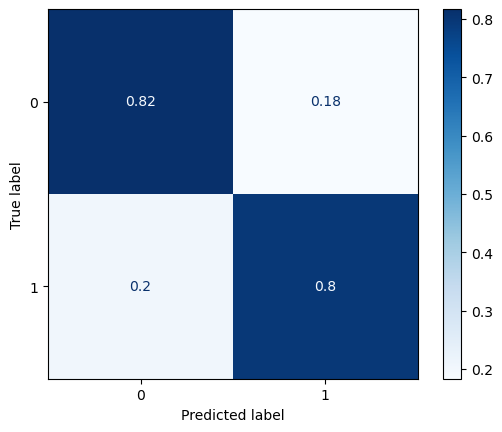

In [696]:
#21-22

tp = TextProcess(stopwords= True, numbers= False, lemmatisation= False)

exp = Experiments(opposition=True)
exp.training_helper_preprocess(X_test_2_op2021_2022)

X_test_2_op2021_2022 = exp.X_train
y_test_2_op2021_2022 = y_test_2_op2021_2022[0].to_numpy()

X_test_2_op2021_2022 = X_test_2_op2021_2022.copy()
X_test_2_op2021_2022['New Summary Facts'] = tp.fit_transform(X_test_2_op2021_2022['New Summary Facts'])                

y_pred_2_op2021_2022 = steps_op_2.predict(X_test_2_op2021_2022)

evaluation(y_pred_2_op2021_2022, y_test_2_op2021_2022, X_test_2_op2021_2022, X_train_2_op, y_train_2_op)

Accuracy:  0.8008320332813312
Classification report:                precision    recall  f1-score   support

           0       0.84      0.80      0.82      1095
           1       0.75      0.80      0.78       828

    accuracy                           0.80      1923
   macro avg       0.80      0.80      0.80      1923
weighted avg       0.80      0.80      0.80      1923

CR:  (0.79718983703994, 0.8011134273046125, 0.7984281694627746, None)
Confusion matrix: 
MCC:  0.5982903990244055
Dummy:  0.5694227769110765


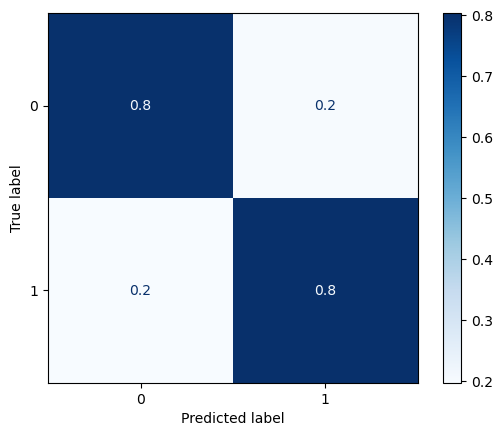

In [697]:
#19-22

tp = TextProcess(stopwords= True, numbers= False, lemmatisation= False)

exp = Experiments(opposition=True)
exp.training_helper_preprocess(X_test_2_op2019_2022)

X_test_2_op2019_2022 = exp.X_train
y_test_2_op2019_2022 = y_test_2_op2019_2022[0].to_numpy()

X_test_2_op2019_2022 = X_test_2_op2019_2022.copy()
X_test_2_op2019_2022['New Summary Facts'] = tp.fit_transform(X_test_2_op2019_2022['New Summary Facts'])                

y_pred_2_op2019_2022 = steps_op_2.predict(X_test_2_op2019_2022)

evaluation(y_pred_2_op2019_2022, y_test_2_op2019_2022, X_test_2_op2019_2022, X_train_2_op, y_train_2_op)

### Feature Importance

In [61]:
maybe = list(steps_pf_1['vect'].vocabulary_.keys())

In [62]:
steps_pf_1_TEST = steps_pf_1['clf'].get_booster().copy()

In [63]:
steps_pf_1['clf'].get_booster().feature_names = maybe

<Axes: xlabel='F score', ylabel='Features'>

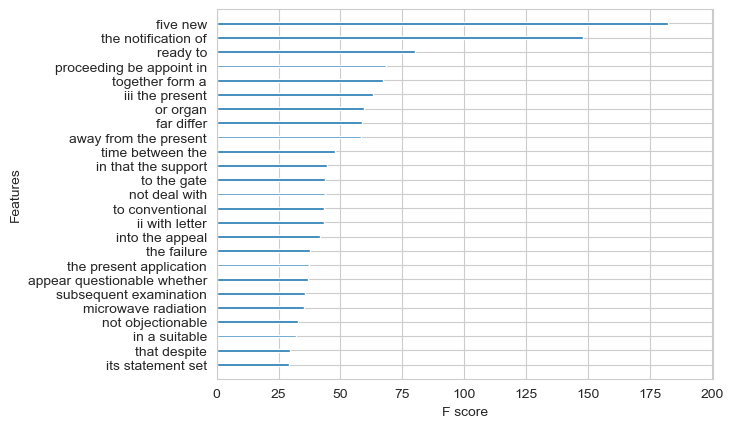

In [65]:
plot_importance(steps_pf_1['clf'],importance_type='gain', max_num_features=25, show_values=False, title=None )

In [750]:
maybe2 = list(steps_op_1[:-1].get_feature_names_out())

In [751]:
prefix = 'num__'
maybe2 = [s[len(prefix):] if s.startswith(prefix) else s for s in maybe2]

In [753]:
token = 'Cats__1'
token2 = 'Cats__2' #patentee and 2 is opponent
maybe2 = ['Patentee_Case_VAR' if (s == token) else s for s in maybe2]
maybe2 = ['Opponent_Case_VAR' if (s == token2) else s for s in maybe2]

In [754]:
steps_op_1['clf'].get_booster().feature_names = maybe2

<Axes: title={'center': 'Feature importance'}, xlabel='F score', ylabel='Features'>

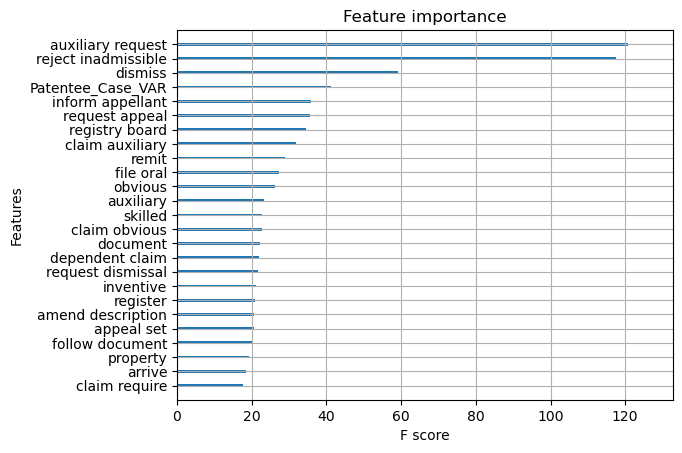

In [755]:
plot_importance(steps_op_1['clf'],importance_type='gain', max_num_features=25, show_values=False )

In [69]:
# TRAIN SVM
# Patent Ref Exp 1
steps_pf_1_SVM = Pipeline([('pre_process',TextProcess(stopwords= False, numbers= True, lemmatisation= False)),('vect', TfidfVectorizer(tokenizer=lambda x:x,preprocessor=lambda x:x, use_idf=True, norm='l2', ngram_range=(4,4),min_df=2)), ('clf', LinearSVC(random_state=42,C=100))])

#exp = Experiments(opposition=False)
#exp.training_helper_preprocess(X_train_1_pf)

#X_train_1_pf = exp.X_train
#y_train_1_pf = y_train_1_pf[0].to_numpy()

steps_pf_1_SVM.fit(X_train_1_pf, y_train_1_pf)


Pipeline(steps=[('pre_process', TextProcess(numbers=True)),
                ('vect',
                 TfidfVectorizer(min_df=2, ngram_range=(4, 4),
                                 preprocessor=<function <lambda> at 0x0000017580474D30>,
                                 tokenizer=<function <lambda> at 0x0000017582D49990>)),
                ('clf', LinearSVC(C=100, random_state=42))])

In [70]:
coefs = steps_pf_1_SVM['clf'].coef_.ravel()
features = list(steps_pf_1_SVM['vect'].vocabulary_.keys())

In [71]:
coefs_ = pd.concat([pd.DataFrame(coefs,columns=['coefs']),pd.DataFrame(features,columns=['features'])],axis=1)
coefs_sorted = coefs_.sort_values(by='coefs',ascending=False)
coefs_sorted.iloc[:20,:]
top_positive_coefficients = coefs_sorted.iloc[:20,:]
top_negative_coefficients = coefs_sorted.iloc[-20:,:]
top_features = pd.concat([top_negative_coefficients,top_positive_coefficients],axis=0)
colors = ['red' if c < 0 else 'blue' for c in top_features['coefs']]
top_features.sort_values(by='coefs',ascending=False,inplace=True)

([<matplotlib.axis.XTick at 0x1765fe9db40>,
 [Text(1, 0, 'and comprises the steps'),
  Text(2, 0, 'in particular of the'),
  Text(3, 0, 'board or of one'),
  Text(4, 0, 'an inventive step on'),
  Text(5, 0, 'the claims do not'),
  Text(6, 0, 'of a subject wherein'),
  Text(7, 0, 'as a whole that'),
  Text(8, 0, 'the communication inter alia'),
  Text(9, 0, 'experimental data submitted during'),
  Text(10, 0, 'of with or of'),
  Text(11, 0, 'to recite the claims'),
  Text(12, 0, 'request reads a system'),
  Text(13, 0, 'for oral proceedings conditional'),
  Text(14, 0, 'of its arguments on'),
  Text(15, 0, 'problem in the light'),
  Text(16, 0, 'a the application in'),
  Text(17, 0, 'completely silent about the'),
  Text(18, 0, 'with the valve member'),
  Text(19, 0, 'against the appellant main'),
  Text(20, 0, 'the problem was thus'),
  Text(21, 0, 'improving the viewing angle'),
  Text(22, 0, 'and page of the'),
  Text(23, 0, 'of the instances of'),
  Text(24, 0, 'issue of article epc

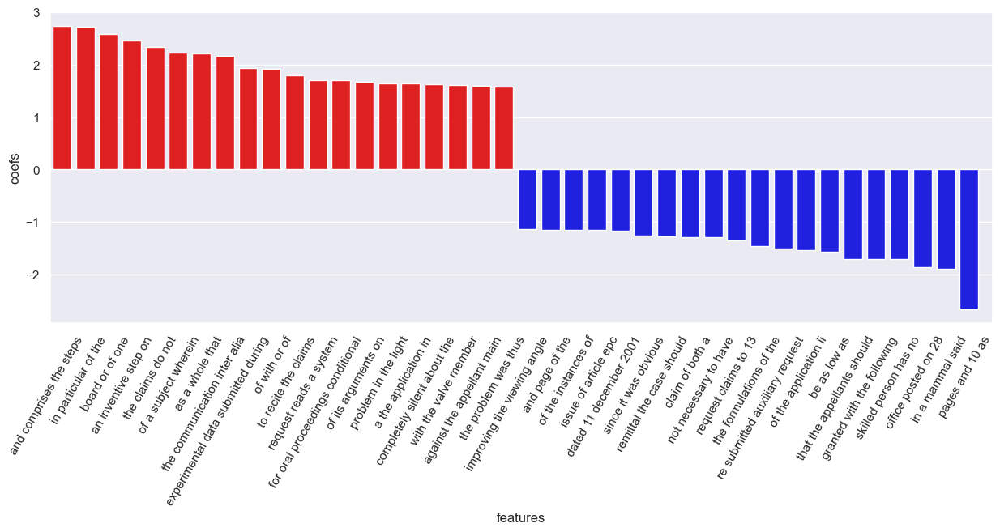

In [72]:
sns.set(rc={"figure.figsize":(15, 5)})

# create plot
g = sns.barplot(data=top_features, y='coefs', x='features' ,palette=colors)

#g.set_xticks(range(len(top_features)))
#feature_names = np.array(feature_names)
plt.xticks(np.arange(1, 1 + len(top_features)), top_features['features'], rotation=60, ha='right')


In [770]:
# TRAIN SVM
# Op Div Exp 2
tp = TextProcess(stopwords= False, numbers= True, lemmatisation= True)

preprocessor = ColumnTransformer(transformers=[("num", TfidfVectorizer(tokenizer=lambda x:x,preprocessor=lambda x:x, use_idf=False, norm='l2', ngram_range=(3,4),min_df=10),'New Summary Facts'),("Cats",Binarizer(),['1','2'])])
steps_op_1_SVM = Pipeline([('vect', preprocessor), ('clf', LinearSVC(random_state=42,C=1))])

exp = Experiments(opposition=True)
exp.training_helper_preprocess(X_train_1_op)

X_train_1_op = exp.X_train
y_train_1_op = y_train_1_op[0].to_numpy()

X_train_1_op = X_train_1_op.copy()
X_train_1_op['New Summary Facts'] = tp.fit_transform(X_train_1_op['New Summary Facts'])                

steps_op_1_SVM.fit(X_train_1_op, y_train_1_op)

Pipeline(steps=[('vect',
                 ColumnTransformer(transformers=[('num',
                                                  TfidfVectorizer(min_df=10,
                                                                  ngram_range=(3,
                                                                               4),
                                                                  preprocessor=<function <lambda> at 0x000002203A204280>,
                                                                  tokenizer=<function <lambda> at 0x0000021FFB949990>,
                                                                  use_idf=False),
                                                  'New Summary Facts'),
                                                 ('Cats', Binarizer(),
                                                  ['1', '2'])])),
                ('clf', LinearSVC(C=1, random_state=42))])

In [776]:
coefs = steps_op_1_SVM['clf'].coef_.ravel()
features = list(steps_op_1_SVM[:-1].get_feature_names_out())

In [779]:
prefix = 'num__'
features = [s[len(prefix):] if s.startswith(prefix) else s for s in features]

In [780]:
coefs_ = pd.concat([pd.DataFrame(coefs,columns=['coefs']),pd.DataFrame(features,columns=['features'])],axis=1)
coefs_sorted = coefs_.sort_values(by='coefs',ascending=False)
coefs_sorted.iloc[:20,:]
top_positive_coefficients = coefs_sorted.iloc[:20,:]
top_negative_coefficients = coefs_sorted.iloc[-20:,:]
top_features = pd.concat([top_negative_coefficients,top_positive_coefficients],axis=0)
colors = ['red' if c < 0 else 'blue' for c in top_features['coefs']]
top_features.sort_values(by='coefs',ascending=False,inplace=True)

Text(0.5, 0, 'N-Gram Features')

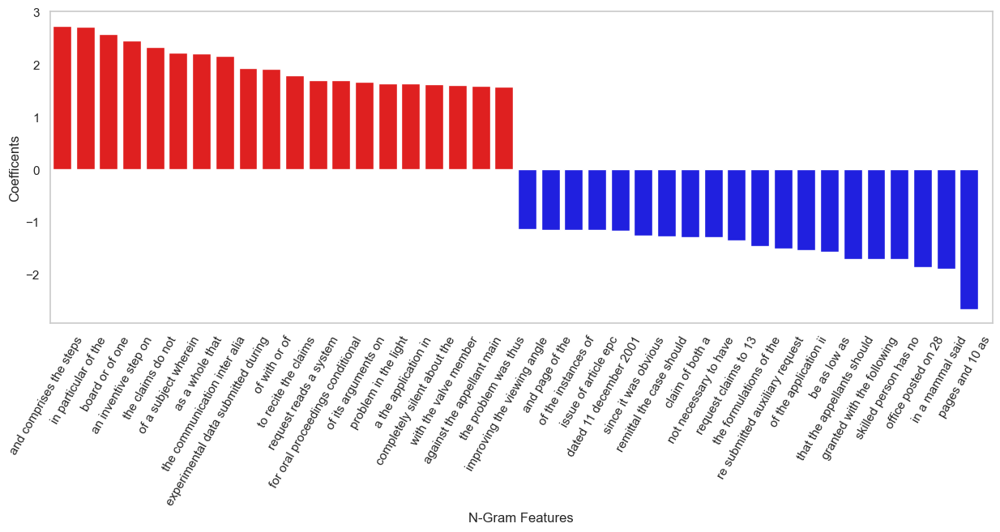

In [78]:
sns.set(rc={"figure.figsize":(15, 5)})
sns.set_style('whitegrid', {'axes.grid' : False})


# create plot
g = sns.barplot(data=top_features, y='coefs', x='features' ,palette=colors)

#g.set_xticks(range(len(top_features)))
#feature_names = np.array(feature_names)
plt.xticks(np.arange(1, 1 + len(top_features)), top_features['features'], rotation=60, ha='right')
plt.ylabel('Coefficents')
plt.xlabel('N-Gram Features')




### Word Embedding Performance

In [36]:
pat_data = pat_1[['word2vec','patent2vec','law2vec','doc2vec']]
pat_data_2 = pat_2[['word2vec','patent2vec','law2vec','doc2vec']]
#op_data = op_1[['word2vec','patent2vec','law2vec','doc2vec']]
#op_data_2 = op_2[['word2vec','patent2vec','law2vec','doc2vec']]

list_docs = [pat_data,pat_data_2]#,op_data,op_data_2]

In [37]:
pd.DataFrame(pat_data.iloc[3])



,XGBoost
word2vec,"{'fit_time': [2907.727578639984, 2908.70949506..."
patent2vec,"{'fit_time': [2878.787368774414, 2909.48655366..."
law2vec,"{'fit_time': [1896.0320851802826, 1909.7064359..."
doc2vec,"{'fit_time': [2897.8818390369415, 2910.1103503..."


In [38]:
word2vec = []
pat2vec = []
law2vec = []
doc2vec = []

In [39]:
    
for doc in list_docs:

    pat_data = doc
    
    for clf in range(len(pat_data)):

        word2vec.append(pat_data.iloc[clf].loc['word2vec'])
        pat2vec.append(pat_data.iloc[clf].loc['patent2vec'])
        law2vec.append(pat_data.iloc[clf].loc['law2vec'])
        doc2vec.append(pat_data.iloc[clf].loc['doc2vec'])

In [40]:
we_list = [word2vec,pat2vec,law2vec,doc2vec]

In [41]:
list_f1_w2v = []
list_f1_p2v = []
list_f1_l2v = []
list_f1_d2v = []

In [42]:
counter = 0

for we in we_list:

    f1 = pd.DataFrame(we)['test_F1']

    for i in f1:

        for j in i:

            if counter == 0:
                list_f1_w2v.append(j)

            elif counter == 1:
                list_f1_p2v.append(j)

            elif counter == 2:
                list_f1_l2v.append(j)

            else:
                list_f1_d2v.append(j)

    counter += 1


In [43]:
df = [list_f1_w2v, list_f1_p2v, list_f1_l2v, list_f1_d2v]

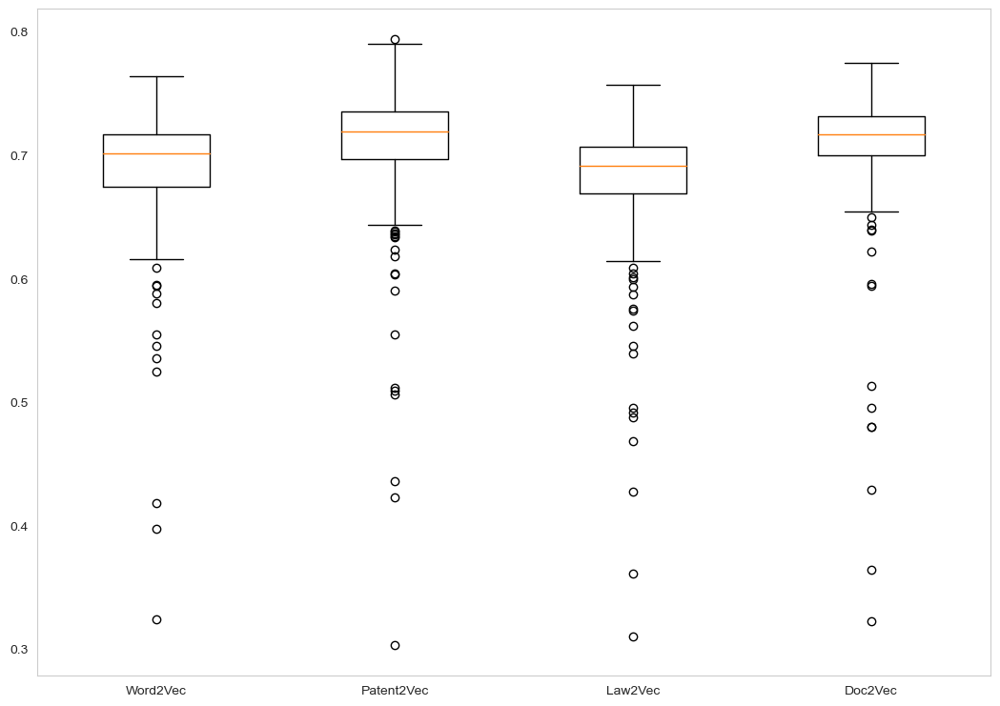

In [44]:
fig = plt.figure(figsize =(10, 7))
 
# Creating axes instance
ax = fig.add_axes([0, 0, 1, 1])
 
# Creating plot
bp = ax.boxplot(df)

ax.set_xticklabels(['Word2Vec','Patent2Vec','Law2Vec','Doc2Vec'])
 
# show plot
plt.show()

1   0.004059266839678085
1   0.6910287622781228
2   0.004213259990955057
2   0.7102202343620004
3   0.004191497156571883
3   0.6824553684764971
4   0.00401037579116336
4   0.7107132426408929


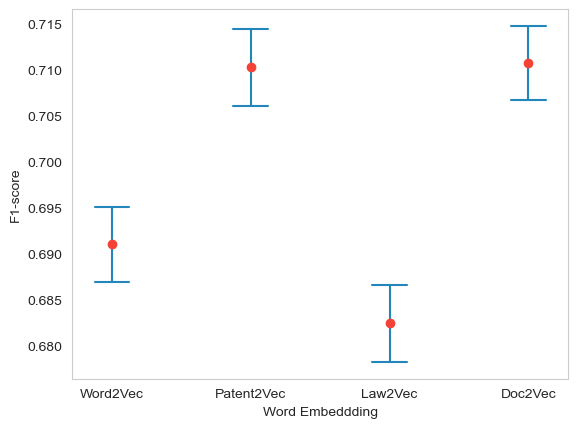

In [47]:
import statistics
from math import sqrt


def plot_confidence_interval(x, values, z=1.96, color='#2187bb', horizontal_line_width=0.25):
    mean = statistics.mean(values)
    stdev = statistics.stdev(values)
    confidence_interval = z * stdev / sqrt(len(values))

    print(x, ' ', confidence_interval)
    print(x, ' ', mean)

    left = x - horizontal_line_width / 2
    top = mean - confidence_interval
    right = x + horizontal_line_width / 2
    bottom = mean + confidence_interval
    plt.plot([x, x], [top, bottom], color=color)
    plt.plot([left, right], [top, top], color=color)
    plt.plot([left, right], [bottom, bottom], color=color)
    plt.plot(x, mean, 'o', color='#f44336')

    return mean, confidence_interval


plt.xticks([1, 2, 3, 4], ['Word2Vec', 'Patent2Vec', 'Law2Vec', 'Doc2Vec'])
plot_confidence_interval(1, df[0])
plot_confidence_interval(2, df[1])
plot_confidence_interval(3, df[2])
plot_confidence_interval(4, df[3])
plt.xlabel('Word Embeddding')
plt.ylabel('F1-score')
plt.show()



### Explainability

#### SHAP

In [8]:
import shap
shap.initjs()


In [9]:
with open('pf_1_model', 'rb') as file:
    pipeline = dill.load(file)

In [10]:
exp = Experiments(opposition=False)
exp.training_helper_preprocess(X_train_1_pf)

X_train_1_pf = exp.X_train
y_train_1_pf = y_train_1_pf[0].to_numpy()

train_1 = pipeline['pre_process'].transform(X_train_1_pf)
train_1 = pipeline['vect'].transform(train_1)

In [11]:
exp = Experiments(opposition=False)
exp.training_helper_preprocess(X_test_1_pf)

X_test_1_pf = exp.X_train
y_test_1_pf = y_test_1_pf[0].to_numpy()

test_1 = pipeline['pre_process'].transform(X_test_1_pf)
test_1 = pipeline['vect'].transform(test_1)

In [12]:
train_1_array = pd.DataFrame(train_1.toarray(), columns = pipeline['vect'].get_feature_names_out())
test_1_array = pd.DataFrame(test_1.toarray(), columns = pipeline['vect'].get_feature_names_out())

In [13]:
explainer = shap.TreeExplainer(pipeline['clf'], feature_names = pipeline['vect'].get_feature_names_out())

In [14]:
shap_values = explainer(train_1)
shap_values_test = explainer(test_1)

In [60]:
#IF LOAD IS LONG
with open('shap_values', 'rb') as file:
    shap_values = dill.load(file)

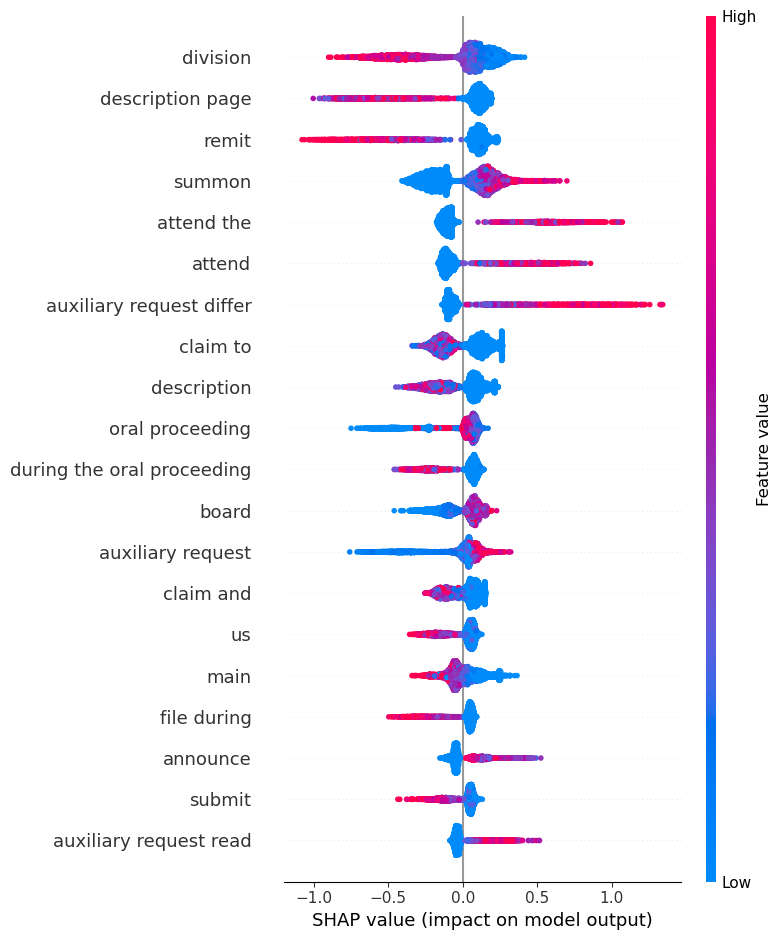

In [15]:
#global importance - training set

shap.summary_plot(shap_values, #Use Shap values array
                features=train_1_array, # Use training set features
                feature_names =pipeline['vect'].get_feature_names_out(),
                plot_type = 'dot',
                show=True,
                color_bar = True,
                max_display = 20,
)

plt.show()

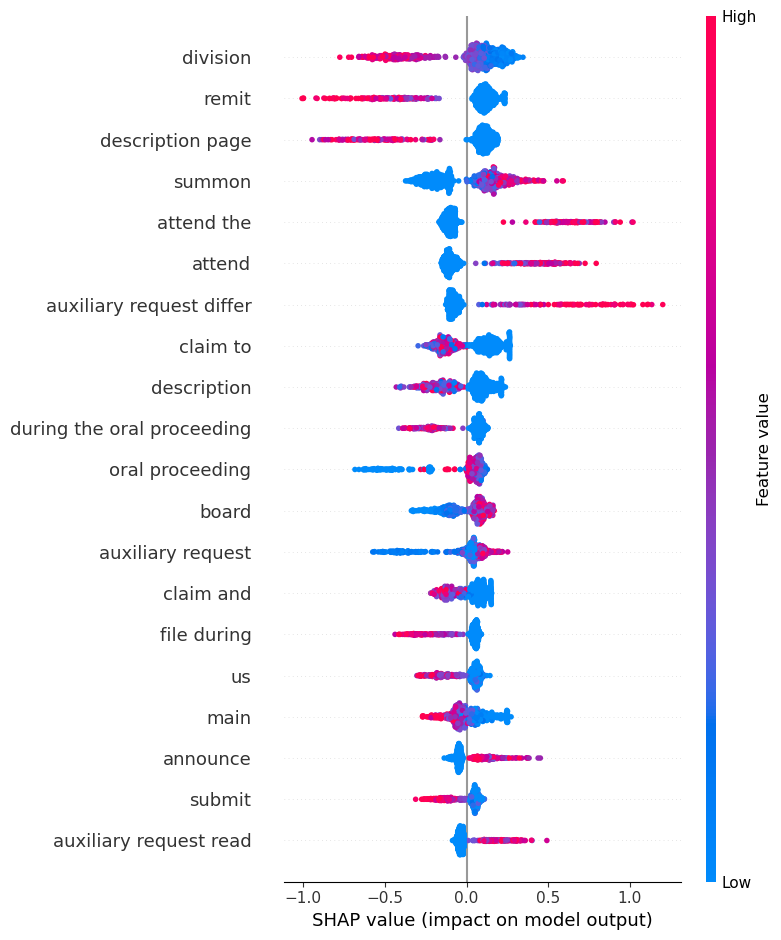

In [16]:
#global importance - test set

shap.summary_plot(shap_values_test, #Use Shap values array
                features=test_1_array, # Use training set features
                feature_names =pipeline['vect'].get_feature_names_out(),
                plot_type = 'dot',
                show=True,
                color_bar = True,
                max_display = 20,
)

plt.show()

In [17]:
y_pred = pipeline['clf'].predict(test_1)

In [18]:
misclassified = np.where(y_test_1_pf != y_pred)

In [19]:
correct = np.where(y_test_1_pf == y_pred)

In [20]:
correct_affirmed = np.where((y_test_1_pf == y_pred)&(y_test_1_pf==1))

In [21]:
np.random.seed(42)

correct_case  = np.random.choice(correct[0])
correct_affirm_case = np.random.choice(correct_affirmed[0])
incorrect_case  = np.random.choice(misclassified[0])

In [22]:
print("CORRECT OUTCOME: ",y_test_1_pf[1])
print("PREDICTED OUTCOME: ",y_pred[1])


force_plot = shap.force_plot(base_value = explainer.expected_value,
                shap_values = shap_values_test.values[1], 
                features=test_1_array.loc[1],
                feature_names=pipeline['vect'].get_feature_names_out(),
                show=False, matplotlib=False)

from IPython.display import HTML
HTML(f"<div style='background-color:Lavender;'>{shap.getjs() + force_plot.html()}</div>")


CORRECT OUTCOME:  1
PREDICTED OUTCOME:  0


In [520]:
X_test_1_pf.iloc[117][0]

' This appeal is against the decision of the examining division to refuse European patent application No. 03012947.2. II. The following document will be referred to in the present decision: D1:  HyPerformix, Inc.: "Optimizer Model for SAP" http://www.hyperformix.com/whitepapers/Optimizer %20Model%20for%20SAP.pdf). III. Claim 1 of the main request submitted during the oral proceedings before the examining division on 20 March 2007 reads: "A computer-implemented method of providing a cost estimate for a data processing system by means of a computer system (100;300), the method comprising the steps of: - selecting of an application program (Ai) of a set of application programs via a user interface means (102, 302), each application program having a number of objects (BOij) stored in a database (104,304), - entering of data being descriptive of a load profile via the user interface, - retrieving a set of sizing coefficients for each object of the selected one of the application programs fr

In [23]:
print("CORRECT OUTCOME: ",y_test_1_pf[correct_case])
print("PREDICTED OUTCOME: ",y_pred[correct_case])


correct_force_plot = shap.force_plot(base_value = explainer.expected_value,
                shap_values = shap_values_test.values[correct_case], 
                features=test_1_array.loc[correct_case],
                feature_names=pipeline['vect'].get_feature_names_out(),
                show=False, matplotlib=False)

from IPython.display import HTML
HTML(f"<div style='background-color:Lavender;'>{shap.getjs() + correct_force_plot.html()}</div>")

#Reversed case

CORRECT OUTCOME:  0
PREDICTED OUTCOME:  0


In [24]:
print("CORRECT OUTCOME: ",y_test_1_pf[incorrect_case])
print("PREDICTED OUTCOME: ",y_pred[incorrect_case])



incorrect_force_plot = shap.force_plot(base_value = explainer.expected_value,
                shap_values = shap_values_test.values[incorrect_case], 
                features=test_1_array.loc[incorrect_case],
                feature_names=pipeline['vect'].get_feature_names_out(),
                show=False, matplotlib=False)

from IPython.display import HTML
HTML(f"<div style='background-color:Lavender;'>{shap.getjs() + incorrect_force_plot.html()}</div>")

#Affirmed case - predicted as reversed

CORRECT OUTCOME:  0
PREDICTED OUTCOME:  1


In [25]:
print("CORRECT OUTCOME: ",y_test_1_pf[correct_affirm_case])
print("PREDICTED OUTCOME: ",y_pred[correct_affirm_case])


correct_affirm_force_plot = shap.force_plot(base_value = explainer.expected_value,
                shap_values = shap_values_test.values[correct_affirm_case], 
                features=test_1_array.loc[correct_affirm_case],
                feature_names=pipeline['vect'].get_feature_names_out(),
                show=False, matplotlib=False)

from IPython.display import HTML
HTML(f"<div style='background-color:Lavender;'>{shap.getjs() + correct_affirm_force_plot.html()}</div>")

#Affirmed case

CORRECT OUTCOME:  1
PREDICTED OUTCOME:  1


### TEXT VIS

In [38]:
np.sum(shap_values_test.values[correct_affirm_case])

0.5203614

In [84]:
shap_df

,754
a,-0.001484
a a,-0.000135
a base,-0.000089
a communication,0.005481
a communication date,-0.000044
...,...
would not,-0.017941
would not be,-0.003658
would not have,-0.000202
write,-0.000196


In [184]:
#lowercase the candidate text and no text processing i think

candidate_text = str(X_test_1_pf[correct_affirm_case]).lower()
candidate_text_2 = str(X_test_1_pf[correct_case]).lower()

In [39]:
#tfidf vetcorised dataframe 

train_1_2 = pd.DataFrame(test_1[correct_affirm_case].toarray(), columns=pipeline['vect'].get_feature_names_out())
train_new = train_1_2.loc[:, ~train_1_2.eq(0).all()].T

In [185]:
train_2 = pd.DataFrame(test_1[correct_case].toarray(), columns=pipeline['vect'].get_feature_names_out())
train_new_2 = train_2.loc[:, ~train_2.eq(0).all()].T

In [188]:
#shap dataframe

shap_df = pd.DataFrame(shap_values_test.values,columns=pipeline['vect'].get_feature_names_out())
shap_df = pd.DataFrame(shap_df.iloc[correct_affirm_case]).T
shap_df = shap_df.loc[:, ~shap_df.eq(0).all()].T

In [189]:
shap_df_2 = pd.DataFrame(shap_values_test.values,columns=pipeline['vect'].get_feature_names_out())
shap_df_2 = pd.DataFrame(shap_df_2.iloc[correct_case]).T
shap_df_2 = shap_df_2.loc[:, ~shap_df_2.eq(0).all()].T

In [279]:
import html
import matplotlib.colors as mcolors


#oNLY FOR N-GRAM 1-3 AT THE MOMENT - DEVELOP FOR 1-4

def check_ngram_appearance(text, shap_df, train_new):
    words = text.split()
    colored_text = ""

    list_candidates = []
    
    for word in range(len(words)):
        #ngram_found = False
        #print('word: ', words[word])
        temp_list = []
        for ngram_size in range(1, 5):  # Check for n-grams of size 1 to 3
            #print('ngram size: ', ngram_size)
            ngram_candidate = " ".join(words[word:word + ngram_size])
            #print('candidate: ', ngram_candidate)
            list_candidates.append(ngram_candidate)

    #print(list_candidates)

    new_list = {}
    # find ones with shap vals
    for ngram in list_candidates:
        try:
            shap_df.loc[ngram]
            new_list[ngram] = shap_df.loc[ngram].values[0]
        except:
            pass

    print(np.sum(list(new_list.values())))
    
    new_list

    weight = 0
    new_sentence = ''

    for word in range(len(words)):
        counter = 3

        for ngram_size in reversed(range(1,5)):
            try:
                ngram_candidate = " ".join(words[word + weight :word + ngram_size + weight])
                #print('candidate: ', ngram_candidate)

                try:
                    new_list[ngram_candidate]
                    #print('success')
                    weight += counter
                    color = continuous_color_scale(new_list[ngram_candidate], min = np.min(list(new_list.values())) , max = np.max(list(new_list.values())))
                    new_sentence += f" <span style='color: {color};'>{html.escape(ngram_candidate)}</span> "
                    #print(f" <span style='color: {color};'>{html.escape(ngram_candidate)}</span> ")
                    break

                except:
                    counter -= 1
                    #print('fail')
                    #print(counter)

                    if counter == -1:
                        new_sentence += f" {html.escape(ngram_candidate)}"
                        break

            except:

                continue

        #print(new_sentence)

    return new_sentence
            
def continuous_color_scale(shap_value, min, max):
    
    #if shap_value < 0:
    #    cmap = plt.get_cmap('blues')  # You can choose a different colormap for negative values
    #else:
    #    cmap = plt.get_cmap('reds')  # You can choose a different colormap for positive values
    cmap = plt.get_cmap('coolwarm')  # You can choose a different colormap
    norm = mcolors.Normalize(vmin=-0.051445436, vmax=0.04715542)
    color = cmap(norm(shap_value))
    hex_color = mcolors.to_hex(color)
    return hex_color            



    

#notes = doesn't work for 4 ngrams
#doesn't prioritise for best shap value - instead prioritises highest possible ngram 
               

In [272]:
std = np.std(list(sentence2.values()))
mean= np.mean(list(sentence2.values()))

In [273]:
mean+std

0.04715542

In [274]:
mean-std

-0.051445436

In [260]:
sentence = check_ngram_appearance(candidate_text, shap_df, train_new)

-0.18109947


In [280]:
sentence2 = check_ngram_appearance(candidate_text_2, shap_df_2, train_new_2)

-0.637067


In [210]:
vals = list(sentence2.values())

In [221]:
sentence2['division']

TypeError: string indices must be integers

In [281]:
from IPython.display import HTML
displayed_html = HTML(sentence2)
displayed_html

In [292]:
explainer2 = shap.TreeExplainer(pipeline['clf'], feature_names = pipeline['vect'].get_feature_names_out(), tokenizer = pipeline['vect'])

In [297]:
shap_2 = explainer2(test_1.toarray())

In [298]:
shap.plots.text(shap_2[0])

AttributeError: 'numpy.float64' object has no attribute 'replace'

In [ ]:
#TRY PREPROCESSED DATA?

### CHATGPT

In [393]:
import langchain as lc
import openai
import json

In [ ]:
# create test dataset no preprocessing raw

In [413]:
y_test_1_pf = y_test_1_pf[0].to_numpy()

In [422]:
gpt_data = X_test_1_pf

In [423]:
gpt_data = pd.DataFrame(gpt_data)

In [431]:
gpt_data = gpt_data.reset_index().drop(['index'],axis=1)

In [432]:
test_data = gpt_data.sample(n=100, random_state=124)

In [433]:
test_data.columns = ['text']

In [434]:
y_outcome = pd.DataFrame(y_test_1_pf, columns=['outcome'])

In [435]:
test_data['outcome'] = y_outcome

In [436]:
test_data

,text,outcome
589,The applicant filed an appeal against the dec...,1
45,This appeal is against the decision of the ex...,0
221,The European patent application No. 94 400 92...,0
86,This appeal is against the decision of the ex...,0
104,This appeal lies from the decision of the exa...,0
...,...,...
484,The appeal is against the decision of the exa...,1
605,The appeal is against the decision of the exa...,1
451,European patent application No. 06 723 938.4 ...,0
164,The appeal lies against the decision of the e...,1


In [ ]:
# create train set for 2-shot learning

In [447]:
train_data = X_train_1_pf

In [448]:
train_data = pd.DataFrame(train_data)

In [449]:
train_data = train_data.reset_index().drop(['index'],axis=1)

In [450]:
y_train_1_pf = y_train_1_pf[0].to_numpy()

In [451]:
y_outcome = pd.DataFrame(y_train_1_pf, columns=['outcome'])

In [452]:
train_data['outcome'] = y_outcome

In [453]:
train_data.columns = ['text','outcome']

In [454]:
train_sample = train_data.sample(2, random_state=42)

In [455]:
train_sample

,text,outcome
2292,This is an appeal against the refusal of appl...,1
1844,European patent application No. 95 924 591.1 ...,0


In [322]:
#openai.organization = 'ORG'
openai.api_key = 'KEY'

In [437]:
test_data_test = test_data[:5]

In [459]:
#zero shot

responses = []

for _, row in test_data.iterrows():

    decision = row['text']

    response = openai.ChatCompletion.create(
    model="gpt-3.5-turbo-16k",
    messages=[
        {"role": "system", "content": "You are a text classifier and your task is to predict the outcome of an appeal case before the European Patent Office's Boards of Appeal, in which a patent was not granted by the examining division. You must predict whether the prior outcome should be Affirmed or Reversed by the appeal board. You should directly output the predicted label only. Your answer should be either one of: [Affirmed, Reversed]. Do not output a sentence."},
        {"role": "user", "content": f"Case: {decision}"}
    ],
    temperature=0,
    top_p=1.0,
    frequency_penalty=0.0,
    presence_penalty=0.0
    )

    responses.append(response.choices[0].message.content)


In [460]:
responses

['Reversed',
 'Affirmed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Affirmed',
 'Affirmed',
 'Affirmed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Affirmed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Affirmed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Affirmed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Affirmed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Affirmed',
 'Reversed',
 'Reversed',
 'Affirmed',
 'Reversed',
 'Affirmed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Affirmed',
 'Reversed',
 'Affirmed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Affirmed',
 'Affirmed',
 'Affirmed',
 'Affirmed',
 'Reversed',

In [458]:
affirmed_example = train_sample.iloc[0]['text']
reversed_example = train_sample.iloc[1]['text']

In [462]:
# few-shot 

import time

few_responses = []

for _, row in test_data.iterrows():

    decision = row['text']

    response = openai.ChatCompletion.create(
    model="gpt-3.5-turbo-16k",
    messages=[
        {"role": "system", "content": f"You are a text classifier and your task is to predict the outcome of an appeal case before the European Patent Office's Boards of Appeal, in which a patent was not granted by the examining division. You must predict whether the prior outcome should be Affirmed or Reversed by the appeal board. You should directly output the predicted label only. Your answer should be either one of: [Affirmed, Reversed]. Do not output a sentence. An example of an affirmed case is: {affirmed_example}; and an example of a reversed case is: {reversed_example}"},
        {"role": "user", "content": f"Case: {decision}"}
    ],
    temperature=0,
    top_p=1.0,
    frequency_penalty=0.0,
    presence_penalty=0.0
    )

    few_responses.append(response.choices[0].message.content)

    time.sleep(20)

In [463]:
few_responses

['Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Affirmed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Affirmed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Affirmed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Affirmed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',
 'Reversed',

In [466]:
responses_processed = [1 if i == 'Affirmed' else 0 for i in responses]
responses_few_processed = [1 if i == 'Affirmed' else 0 for i in few_responses]


In [470]:
y_real = test_data['outcome']

Accuracy:  0.54
Classification report:                precision    recall  f1-score   support

           0       0.46      0.92      0.61        39
           1       0.86      0.30      0.44        61

    accuracy                           0.54       100
   macro avg       0.66      0.61      0.52       100
weighted avg       0.70      0.54      0.51       100

CR:  (0.6564195298372513, 0.609079445145019, 0.5245969408846631, None)
MCC:  0.2612443723756905
Dummy:  0.61
[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
CR222:  (0.305, 0.5, 0.37888198757763975, None)
Confusion matrix: 


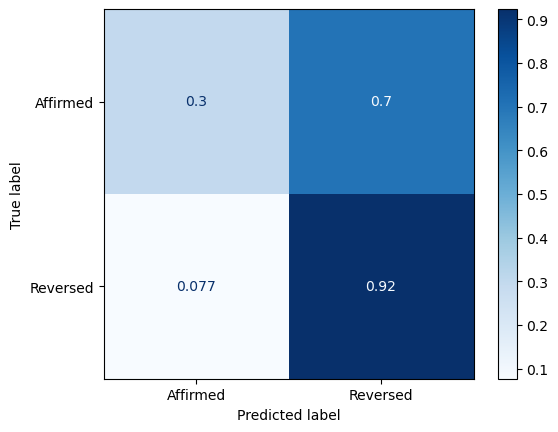

In [473]:
evaluation(responses_processed, y_real, test_data)

Accuracy:  0.37
Classification report:                precision    recall  f1-score   support

           0       0.38      0.92      0.53        39
           1       0.25      0.02      0.03        61

    accuracy                           0.37       100
   macro avg       0.31      0.47      0.28       100
weighted avg       0.30      0.37      0.23       100

CR:  (0.3125, 0.469735182849937, 0.28205128205128205, None)
MCC:  -0.15066058828554763
Dummy:  0.61
[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
CR222:  (0.305, 0.5, 0.37888198757763975, None)
Confusion matrix: 


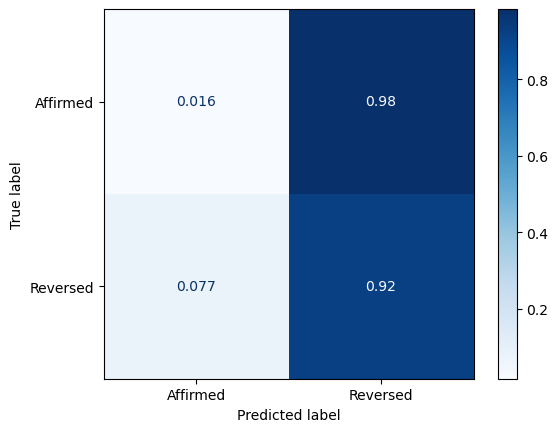

In [475]:
evaluation(responses_few_processed, y_real, test_data)

In [503]:
X_test_1_pf = X_test_1_pf.reset_index().drop(['index'],axis=1)

In [507]:
X_test_1_pf = X_test_1_pf.sample(n=100, random_state=124)

In [508]:
exp = Experiments(opposition=False)
exp.training_helper_preprocess(X_test_1_pf)

test_data_results = exp.X_train

In [510]:
results_xgb = pipeline.predict(test_data_results)

Accuracy:  0.85
Classification report:                precision    recall  f1-score   support

           0       0.76      0.90      0.82        39
           1       0.93      0.82      0.87        61

    accuracy                           0.85       100
   macro avg       0.84      0.86      0.85       100
weighted avg       0.86      0.85      0.85       100

CR:  (0.8433977455716586, 0.8585540142917192, 0.8465473145780051, None)
MCC:  0.7017881166661193
Dummy:  0.61
[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]
CR222:  (0.305, 0.5, 0.37888198757763975, None)
Confusion matrix: 


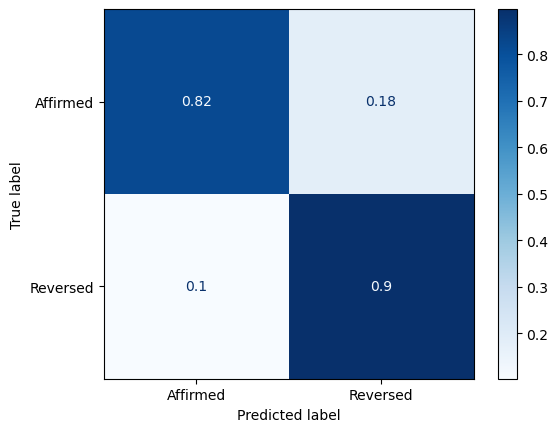

In [512]:
evaluation(results_xgb, y_real, test_data_results)

In [531]:
results = [ 0.37, 0.54, 0.61, 0.85]
models = [ 'ChatGPT-Few-shot', 'ChatGPT-Zero-Shot', 'Majority Baseline', 'XGBoost']

(array([0, 1, 2, 3]),
 [Text(0, 0, 'ChatGPT-Few-shot'),
  Text(1, 0, 'ChatGPT-Zero-Shot'),
  Text(2, 0, 'Majority Baseline'),
  Text(3, 0, 'XGBoost')])

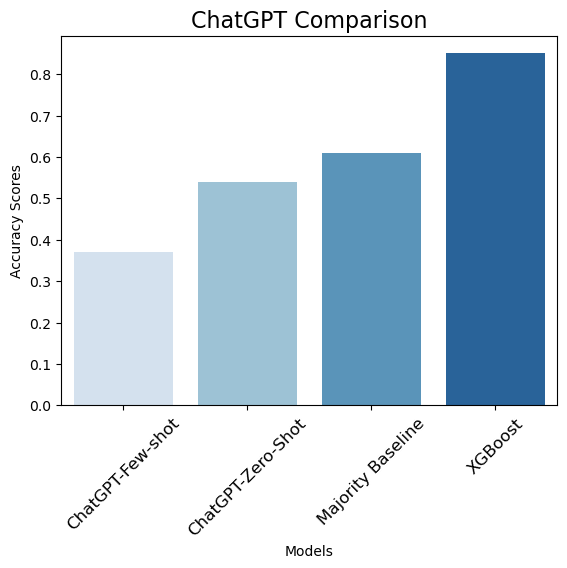

In [532]:
sns.barplot(x = models, y=results, palette='Blues')

plt.title("ChatGPT Comparison", fontsize=16)  # Set plot title
plt.xlabel("Models", fontsize=10)  # Set x-axis label
plt.ylabel("Accuracy Scores", fontsize=10)  # Set y-axis label
plt.xticks(rotation=45, fontsize=12)

